## Advanced Lane Finding

## Importing Libraries

In [82]:
import cv2
from helpers import*
import matplotlib.image as mpimg
import glob
import os
import random
from tqdm import tqdm_notebook as tqdm
from moviepy.editor import VideoFileClip
from IPython.display import HTML

%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Loading and Visualizing Calibration Images

Calibration Images are of shape: (720, 1280, 3)


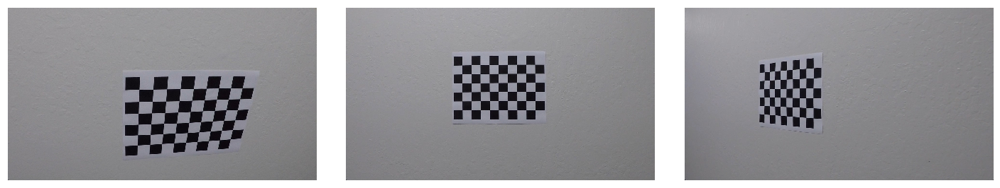

In [9]:
#Reading Images
img_1 = mpimg.imread('camera_cal/calibration'+str(10)+'.jpg')
img_2 = mpimg.imread('camera_cal/calibration'+str(6)+'.jpg')
img_3 = mpimg.imread('camera_cal/calibration'+str(7)+'.jpg')
image_shape = img_1.shape
print("Calibration Images are of shape: {}".format(image_shape))

plot_images([img_1,img_2,img_3],(1,3),(20,5),save_plot=1,filepath='output_images/calibration_imgs_vis')

## Function to Calibrate Camera and Undistort Images

In [10]:
def calibrate(cal_images_path,nx:'No. of corners in any given row', \
              ny: 'No. of corners in any given column')->'Calibration Parameters':

    objpoints = []
    imgpoints = []

    objp = np.zeros((nx*ny,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

    # List of paths to the calibration images
    fnames = glob.glob(cal_images_path)

    for fname in fnames:
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
        if ret:
            objpoints.append(objp)
            imgpoints.append(corners)

    # Using the object and image points to caliberate the camera.
    # Also, computing the camera matrix and distortion coefficients
    return cv2.calibrateCamera(objpoints, imgpoints, image_shape[:2],None,None)

def undistort(img, cameraMatrix, distortionCoeffs):
    return cv2.undistort(img, cameraMatrix, distortionCoeffs, None, cameraMatrix)

## Camera Calibration
There are 9 corners in a row and 6 corners in a column in the calibration images being used

In [11]:
ret, cameraMatrix, distortionCoeffs, rvecs, tvecs = calibrate("camera_cal/calibration*.jpg",9,6)

## Testing Calibration

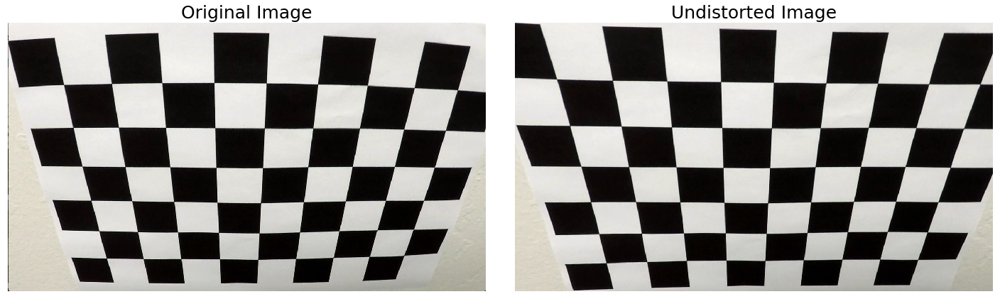

In [12]:
img = mpimg.imread('camera_cal/calibration2.jpg')
undistorted = undistort(img,cameraMatrix, distortionCoeffs)

#Plotting
plot_images([img,undistorted],(1,2),(20,6),['Original Image','Undistorted Image'],
            save_plot=1,filepath='output_images/corrected_cal_img_vis',title_font=25)

# Loading Test Data and Visualization

There were 8 test images found.
The Images are of the shape: (720, 1280, 3)

A Sample image is as under:


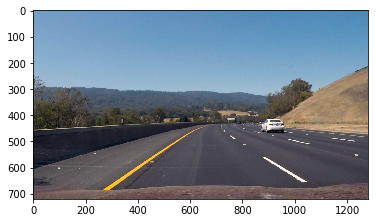

In [13]:
test_images_root_directory = "test_images/"
image_paths = os.listdir(test_images_root_directory)
test_images = [[],[]]

for i in range(len(image_paths)):
    test_images[0].append(mpimg.imread(test_images_root_directory+image_paths[i]))
    test_images[1].append(image_paths[i][:-4])

total_images = len(test_images[0])    
print("There were",total_images,"test images found.")
print("The Images are of the shape: {}".format(np.shape(test_images[0][0])))
print("\nA Sample image is as under:")
plt.imshow(random.choice(test_images[0]))
plt.show()

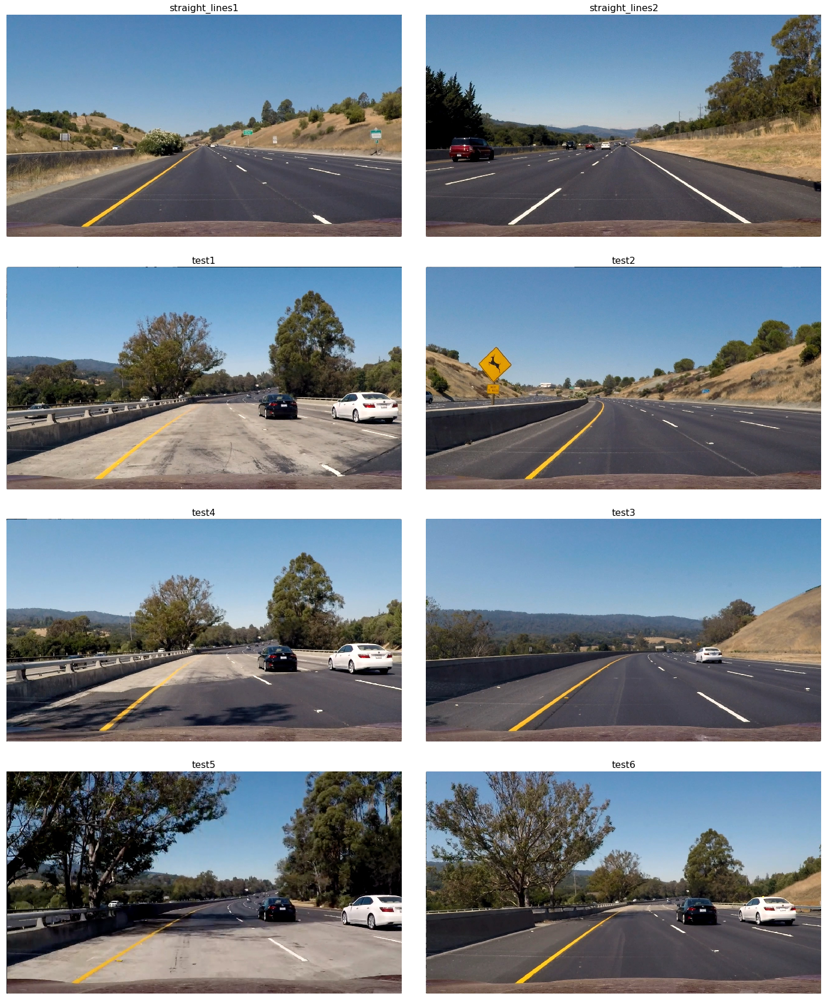

In [14]:
"""DISPLAY ALL TEST IMAGES"""

plot_images(test_images[0],(4,2),(20,24),test_images[1],
            save_plot=1,filepath='output_images/test_imgs_vis')

# Pre-processing the data

**The aim is to find the lanes from the undistorted image. To do this I have used the following techniques:**

* **Undistorting the Images**


* **Sobel Filtering**
    * Sobel X
    * Sobel Y
    * Gradient Magnitude
    * Gradient Direction
        * **Combined Sobel**
    
    
* **Colorspace Exploration**
    * HLS Colorspace
    * LAB Colorspace
    * RGB Colorspace
        * **Combined Color**


* **Combined Sobel and Color**



### Undistorting the Images

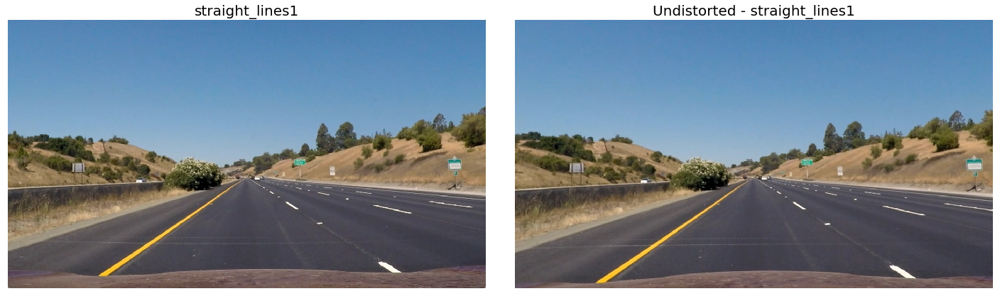

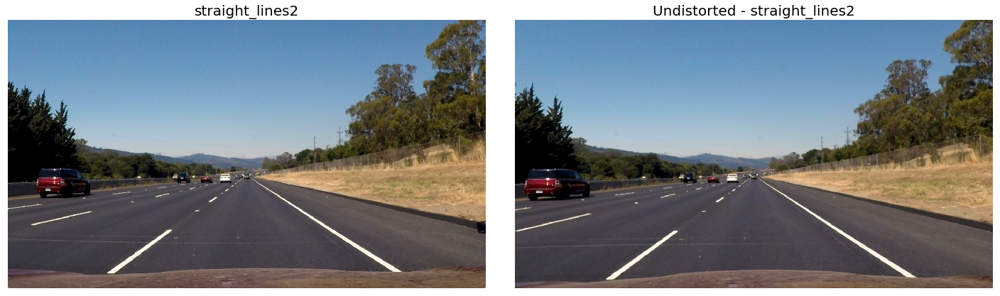

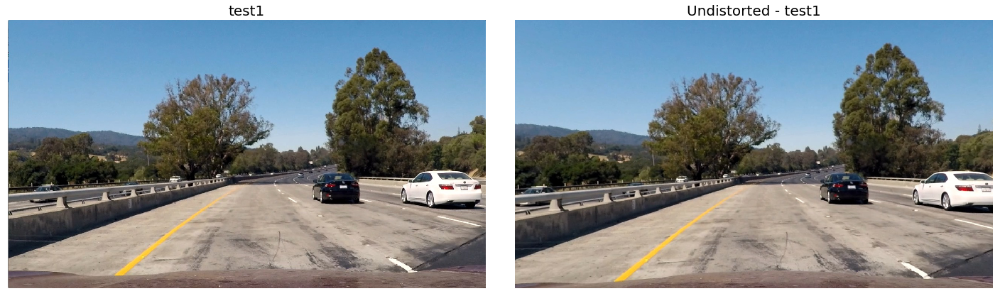

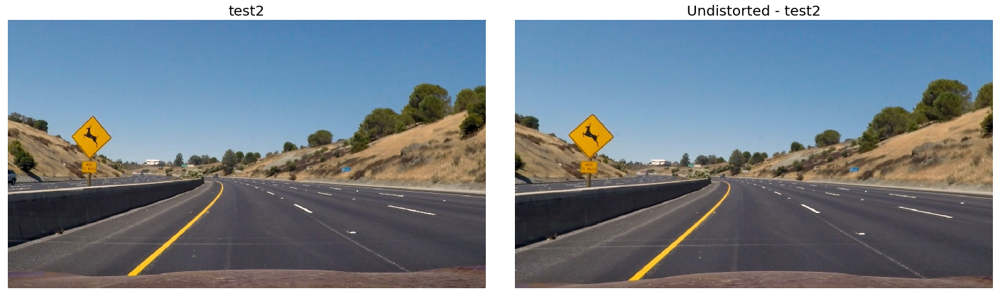

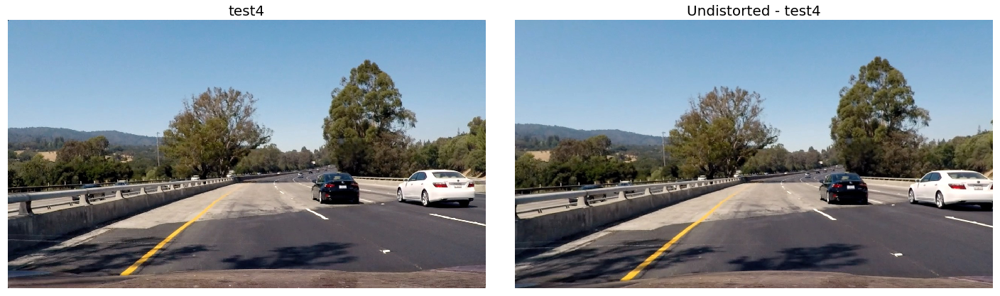

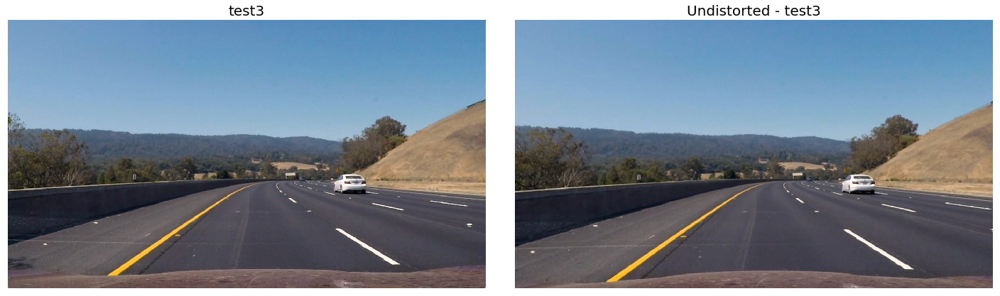

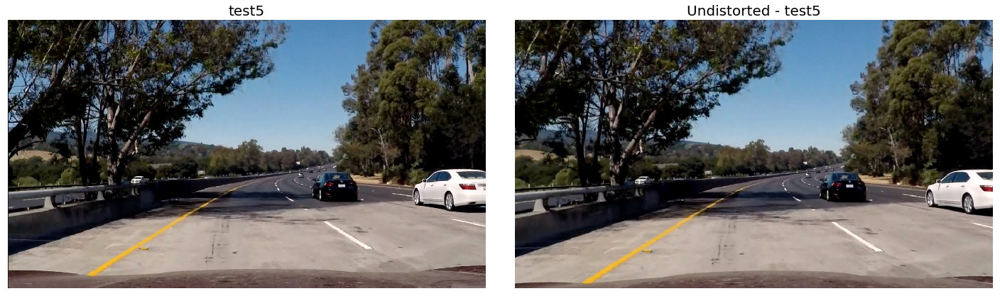

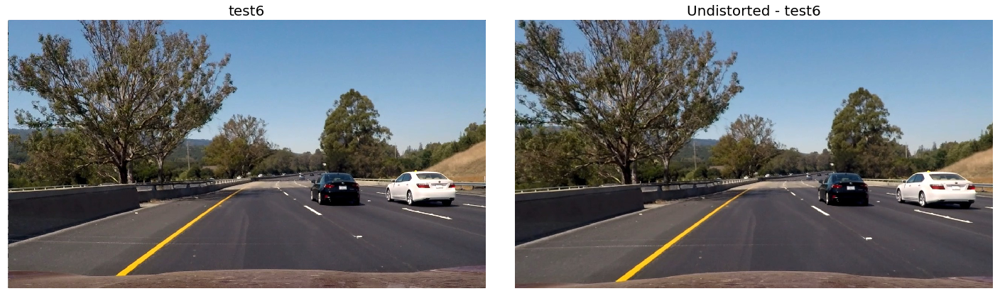

In [15]:
undistorted_imgs = [[],[]]
for i in range(total_images):
    undistorted_imgs[0].append(undistort(test_images[0][i],cameraMatrix, distortionCoeffs))
    undistorted_imgs[1].append('Undistorted - '+test_images[1][i])
    plot_images([test_images[0][i],undistorted_imgs[0][i]],(1,2),(20,6),[test_images[1][i],undistorted_imgs[1][i]],
            save_plot=0,filepath='output_images/undistorted_imgs/undistort_vis_'+test_images[1][i],title_font=20)

### Helper Functions

In [16]:
def applyBinaryThresh(image, lower, upper, inverted=False):
    if (inverted):
        binary_output = np.ones_like(image)
        binary_output[((image > lower) & (image <= upper))] = 0
    else:
        binary_output = np.zeros_like(image)
        binary_output[((image > lower) & (image <= upper))] = 1

    return binary_output

def combineThresh(img1, img2):
    image = np.bitwise_or(img1, img2)
    return image

## Sobel Filtering
* Sobel X
* Sobel Y
* Gradient Magnitude
* Gradient Direction
    * **Combined Sobel**
        
### Calculating Directional Gradients & Thresholding

In [17]:
def abs_sobel_thresh(gray, orient='x', thresh_min=0, thresh_max=255):
    
    # Applying x or y gradient with the OpenCV Sobel() function
    # and taking the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
        
    # Rescaling back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Creating a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output = applyBinaryThresh(scaled_sobel, thresh_min, thresh_max)
    
    return binary_output

### Thresholding Sobel x

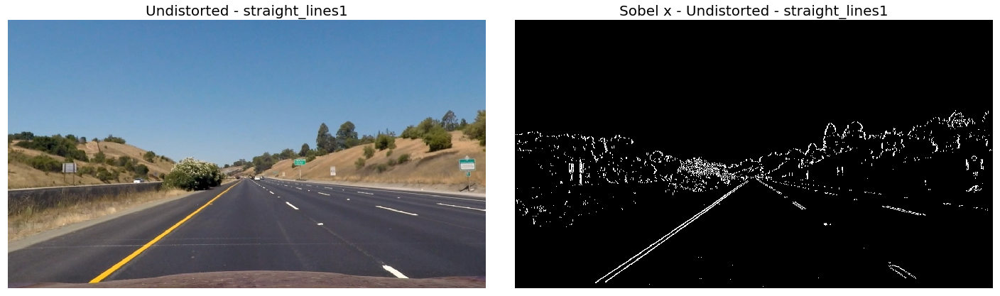

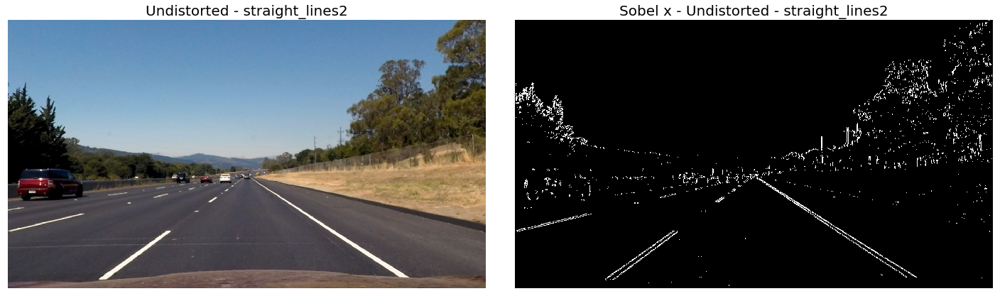

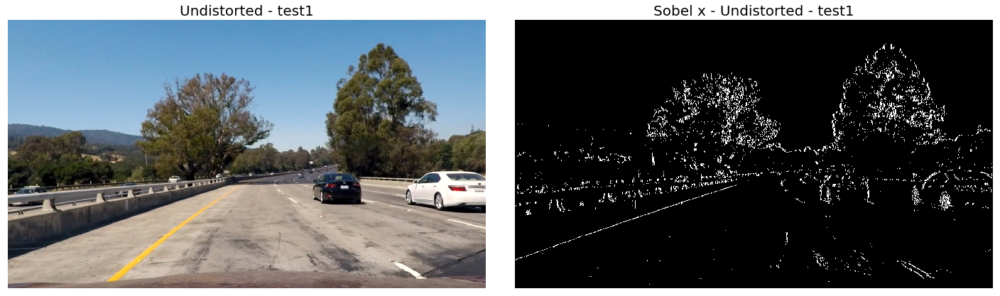

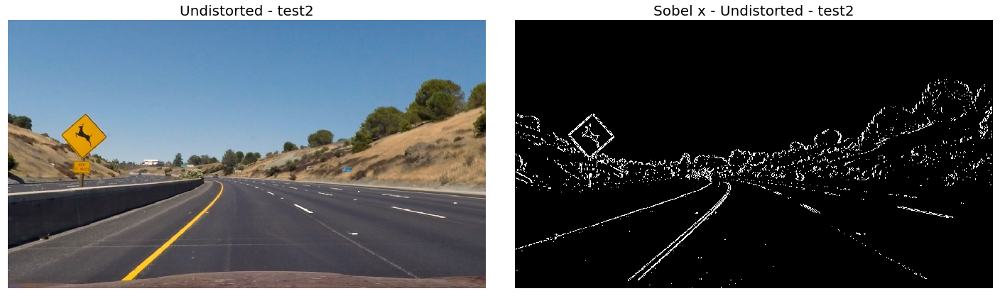

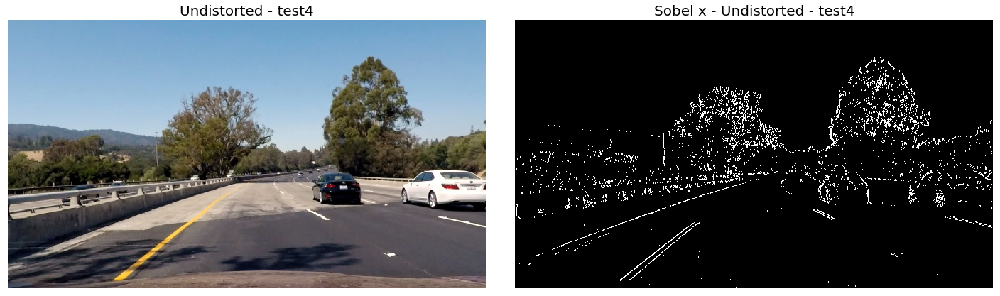

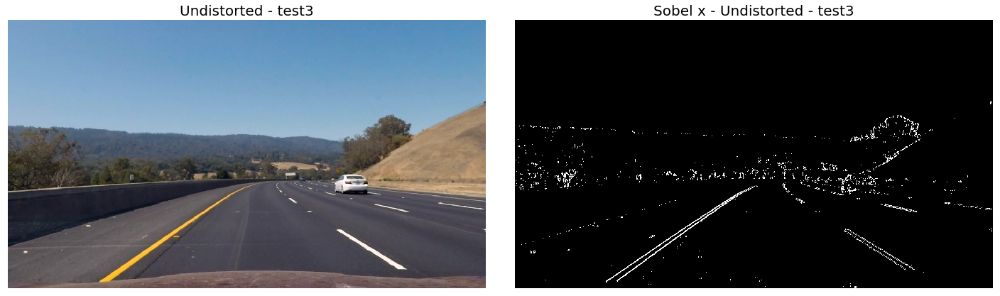

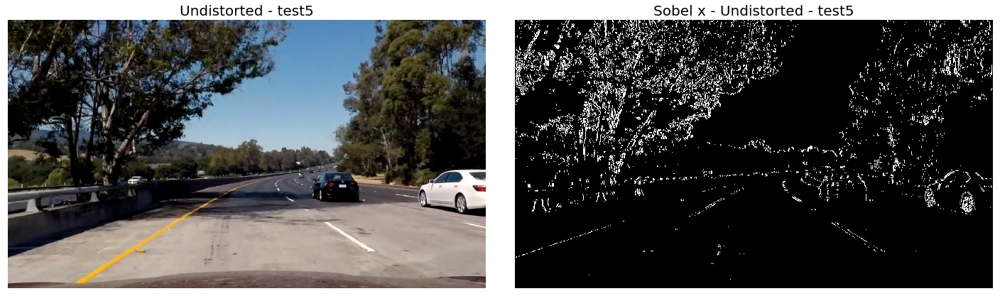

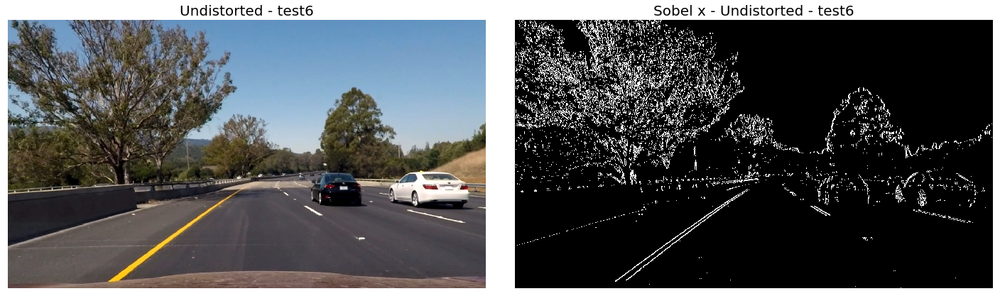

In [18]:
sobel_x = [[],[]]

# Thresholding Parameters
sobel_x_low = 30
sobel_x_high = 110

for i in range(total_images):
    gray = cv2.cvtColor(undistorted_imgs[0][i], cv2.COLOR_RGB2GRAY)
    sobel_x[0].append(abs_sobel_thresh(gray, 'x', sobel_x_low, sobel_x_high)) #Image
    sobel_x[1].append('Sobel x - '+undistorted_imgs[1][i]) #Title
    plot_images([undistorted_imgs[0][i],sobel_x[0][i]],(1,2),(20,6),
                [undistorted_imgs[1][i],sobel_x[1][i]],[None,'gray'],
                save_plot=1,filepath='output_images/sobel_filtered/sobel_x_thresh_vis_'+test_images[1][i],title_font=20)

### Thresholding Sobel y

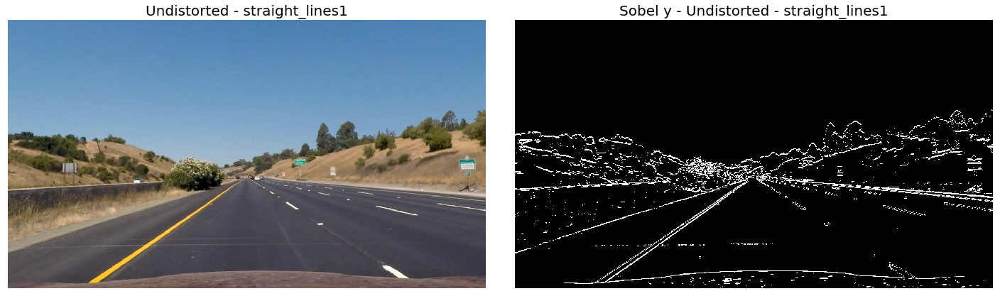

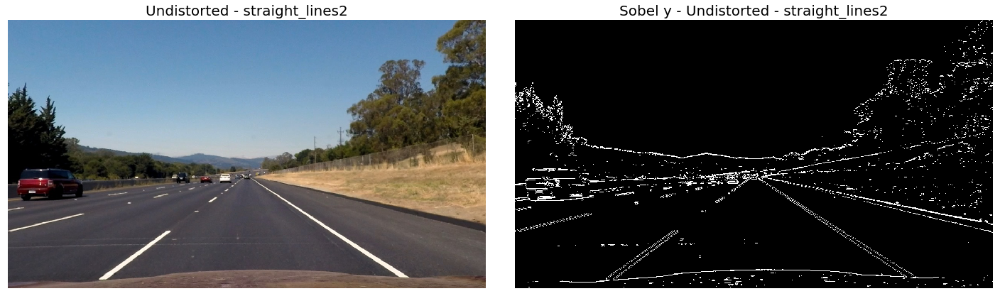

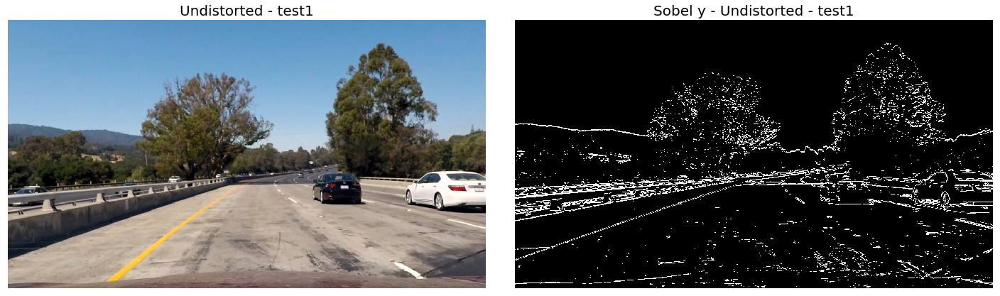

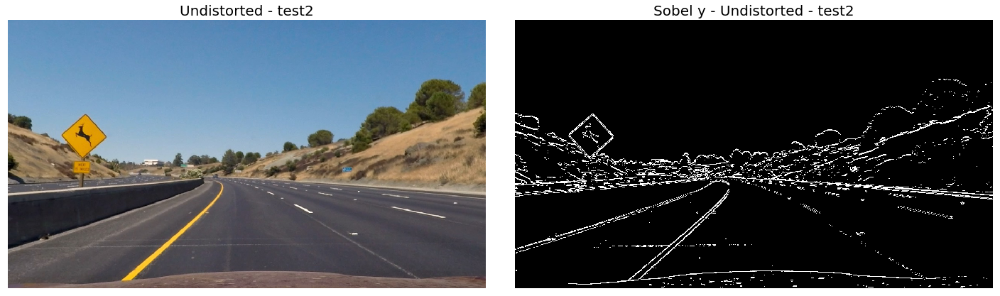

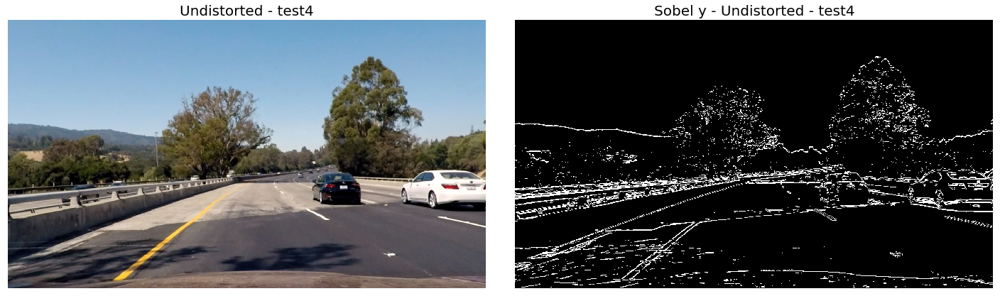

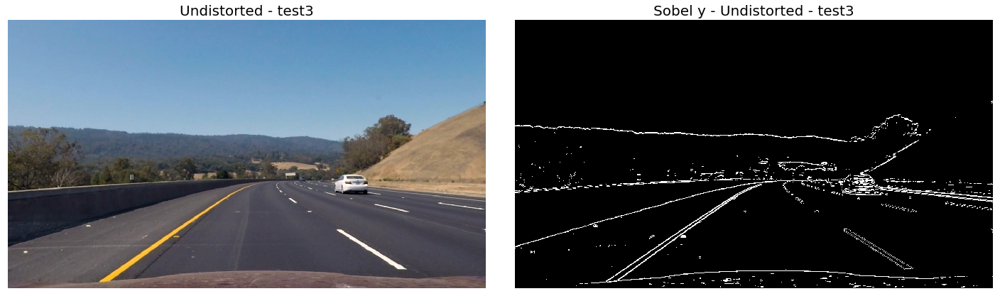

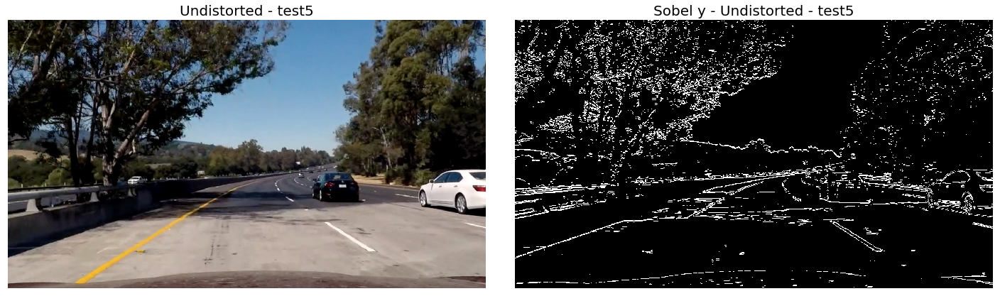

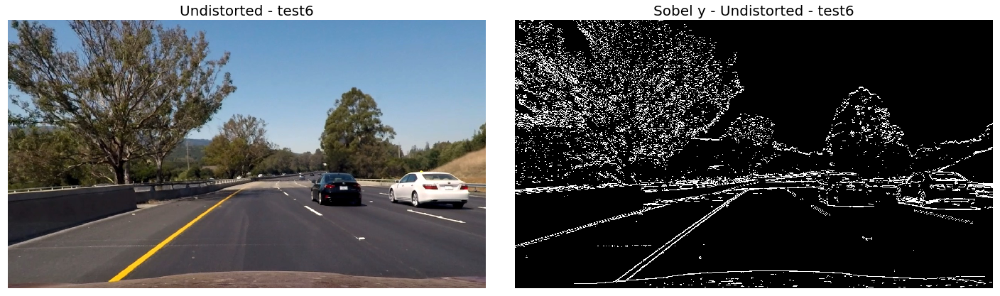

In [19]:
sobel_y = [[],[]]

# Thresholding Parameters
sobel_y_low = 30
sobel_y_high = 110

for i in range(total_images):
    gray = cv2.cvtColor(undistorted_imgs[0][i], cv2.COLOR_RGB2GRAY)
    sobel_y[0].append(abs_sobel_thresh(gray, 'y', sobel_y_low, sobel_y_high)) #Image
    sobel_y[1].append('Sobel y - '+undistorted_imgs[1][i]) #Title
    plot_images([undistorted_imgs[0][i],sobel_y[0][i]],(1,2),(20,6),
                [undistorted_imgs[1][i],sobel_y[1][i]],[None,'gray'],
                save_plot=1,filepath='output_images/sobel_filtered/sobel_y_thresh_vis_'+test_images[1][i],title_font=20)

### Calculating Gradient Magnitude and Thresholding

In [20]:
def mag_thresh(gray, sobel_kernel=3, mag_thresh=(0, 255)):
    # Taking both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculating the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    
    # Rescaling back to 8 bit integer
    scaled_gradmag = np.uint8(255*gradmag/np.max(gradmag)) 
    # Creating a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(scaled_gradmag)
    binary_output = applyBinaryThresh(scaled_gradmag, mag_thresh[0], mag_thresh[1])
    
    return binary_output

### Thresholding Sobel x and y Magnitude

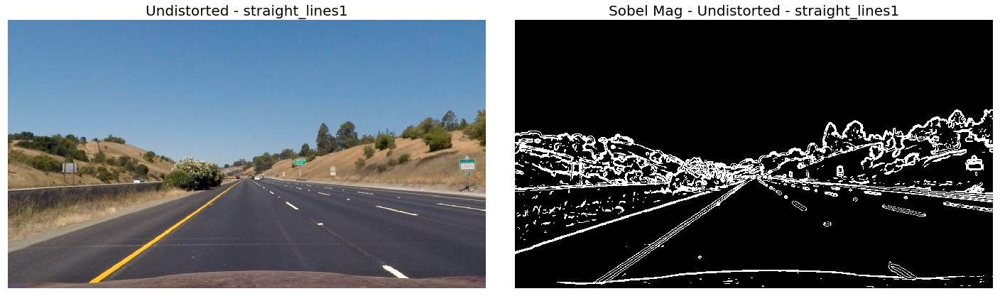

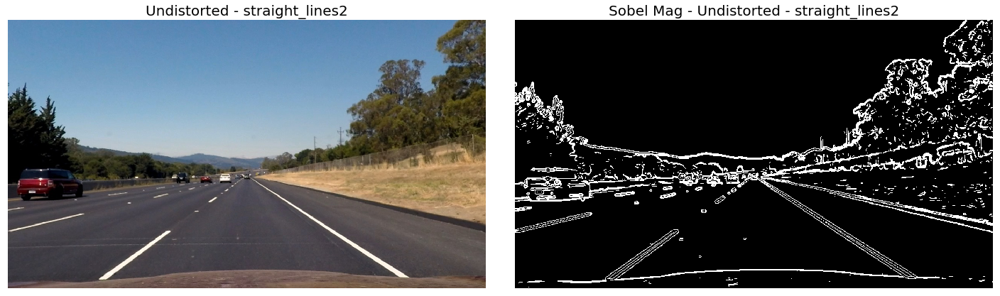

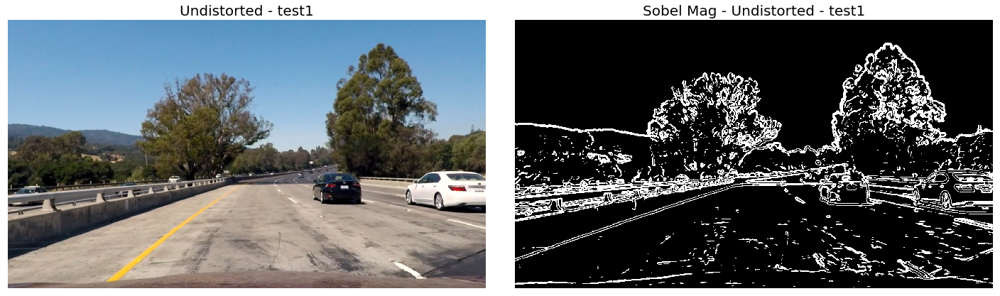

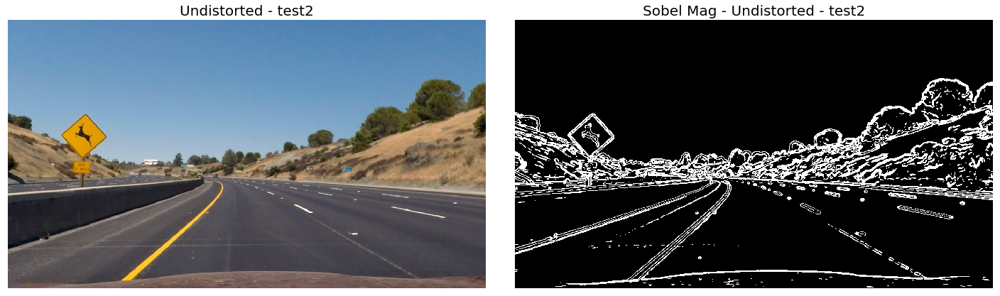

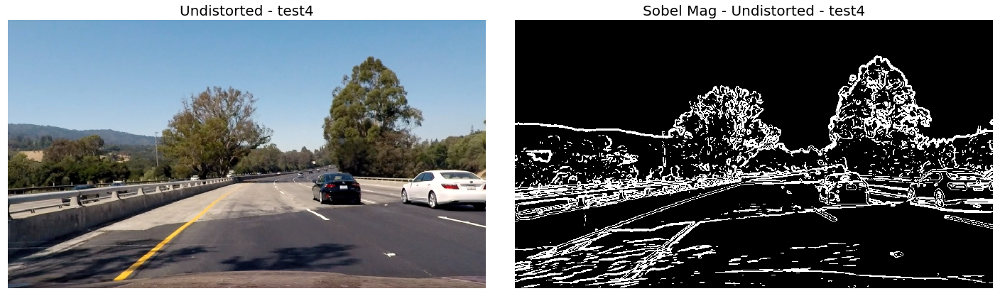

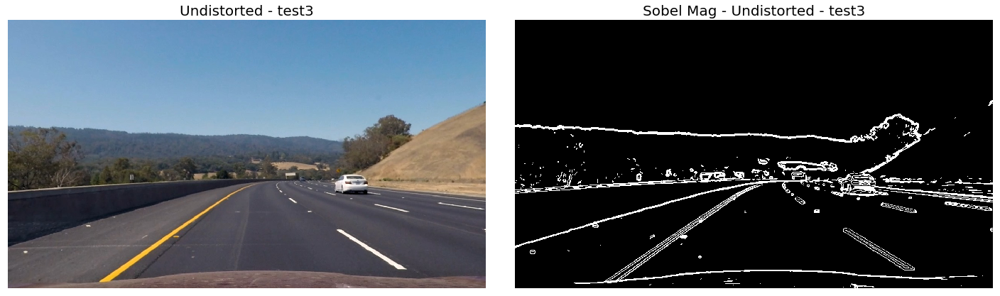

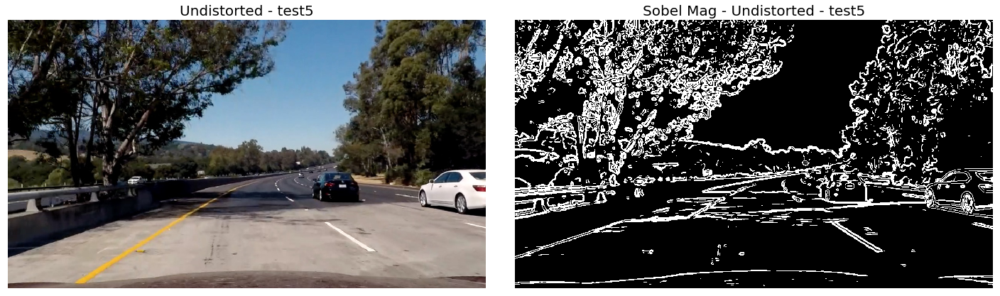

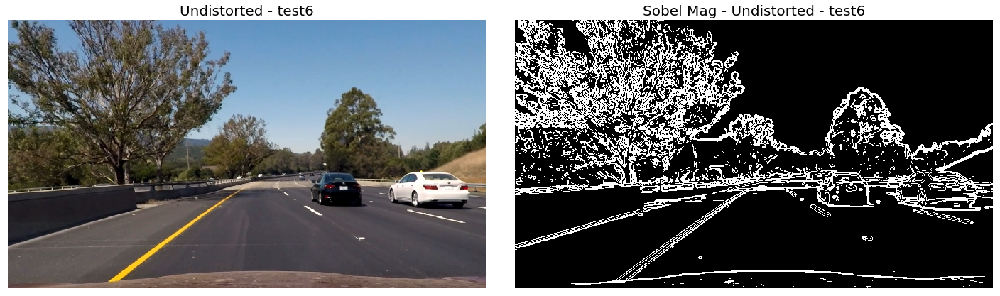

In [21]:
sobel_mag = [[],[]]

# Thresholding Parameters
sobel_kernel = 15
sobel_mag_low = 30
sobel_mag_high = 110

for i in range(total_images):
    gray = cv2.cvtColor(undistorted_imgs[0][i], cv2.COLOR_RGB2GRAY)
    sobel_mag[0].append(mag_thresh(gray, sobel_kernel, (sobel_mag_low, sobel_mag_high))) #Image
    sobel_mag[1].append('Sobel Mag - '+undistorted_imgs[1][i]) #Title
    plot_images([undistorted_imgs[0][i],sobel_mag[0][i]],(1,2),(20,6),
                [undistorted_imgs[1][i],sobel_mag[1][i]],[None,'gray'],
                save_plot=1,filepath='output_images/sobel_filtered/sobel_mag_thresh_vis_'+test_images[1][i],title_font=20)

### Calculating Gradient Direction and Thresholding

In [22]:
def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculating the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Taking the absolute values of the gradient direction, 
    # and applying a threshold
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    
    # Rescaling back to 8 bit integer
    absgraddir = np.uint8(np.absolute(absgraddir))
    
    # Creating a binary image of ones where threshold is met, zeros otherwise
    binary_output =  np.zeros_like(absgraddir)
    binary_output = applyBinaryThresh(absgraddir, thresh[0], thresh[1],inverted=True)

    return binary_output

### Thresholding Gradient Direction

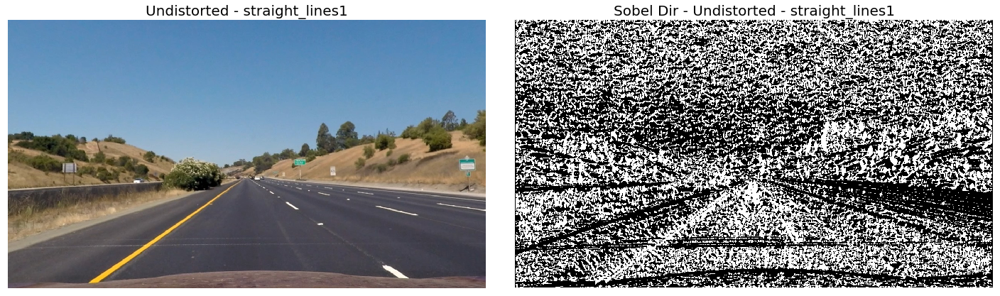

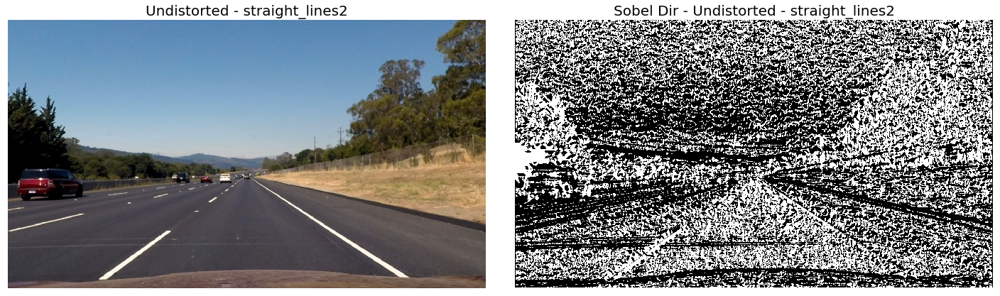

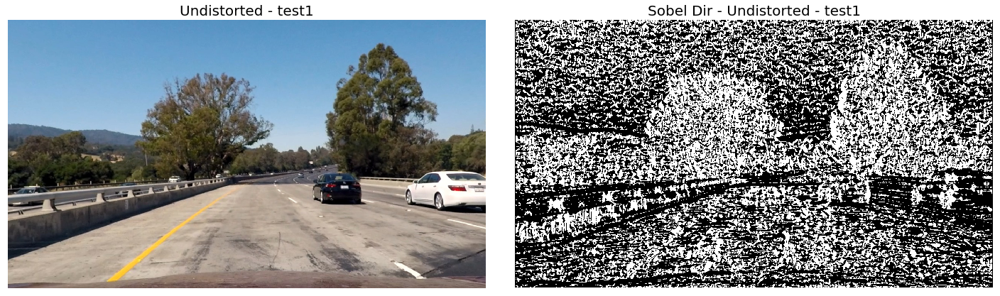

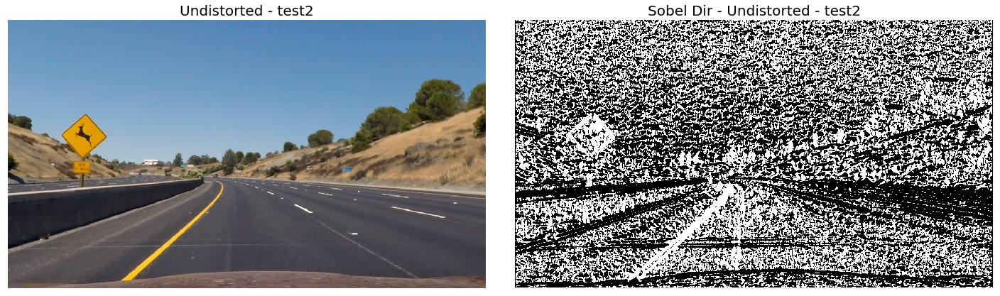

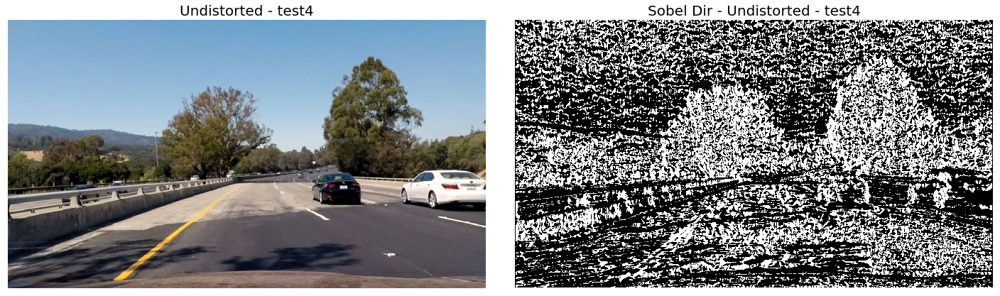

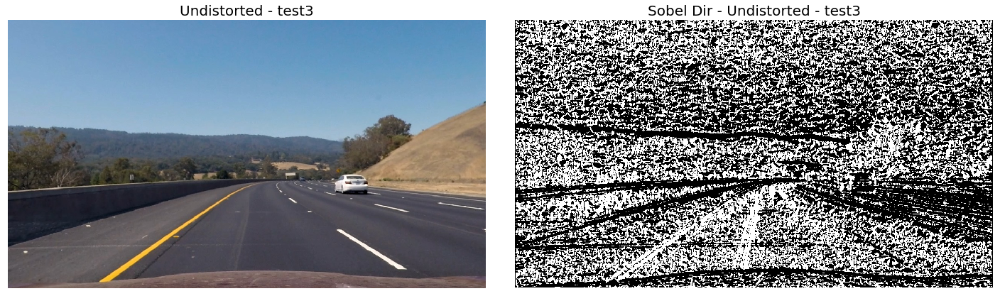

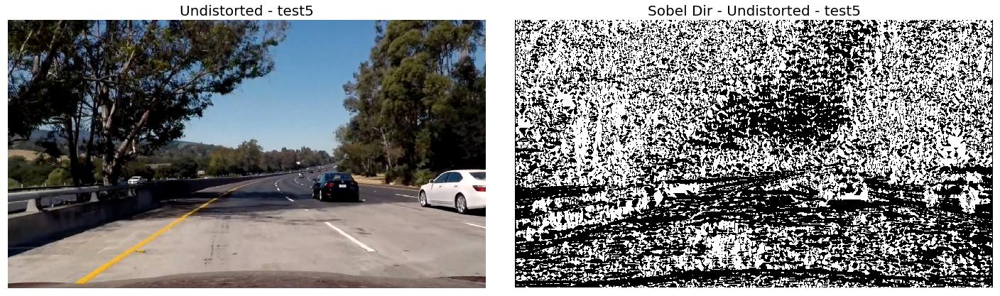

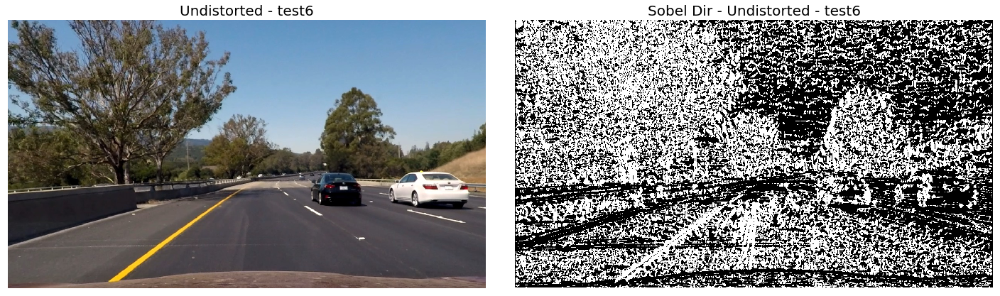

In [23]:
sobel_dir = [[],[]]

# Thresholding Parameters
sobel_kernel = 15
sobel_dir_low = 0.7
sobel_dir_high = 1.3

for i in range(total_images):
    gray = cv2.cvtColor(undistorted_imgs[0][i], cv2.COLOR_RGB2GRAY)
    sobel_dir[0].append(dir_threshold(gray, sobel_kernel, (sobel_dir_low, sobel_dir_high))) #Image
    sobel_dir[1].append('Sobel Dir - '+undistorted_imgs[1][i]) #Title
    plot_images([undistorted_imgs[0][i],sobel_dir[0][i]],(1,2),(20,6),
                [undistorted_imgs[1][i],sobel_dir[1][i]],[None,'gray'],
                save_plot=1,filepath='output_images/sobel_filtered/sobel_dir_thresh_vis_'+test_images[1][i],title_font=20)

### Combining the Gradient, Magnitude and Direction Thresholds

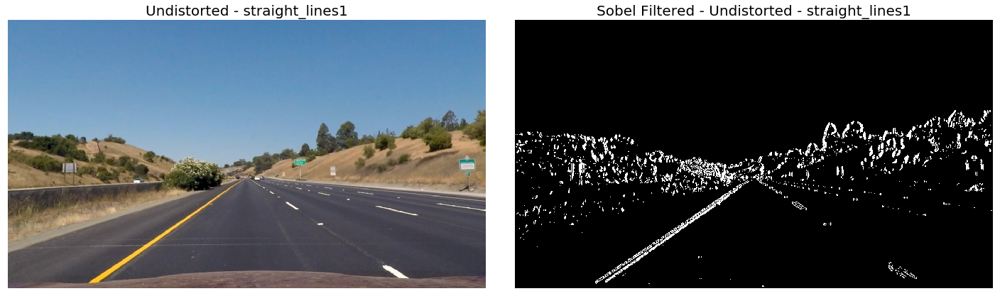

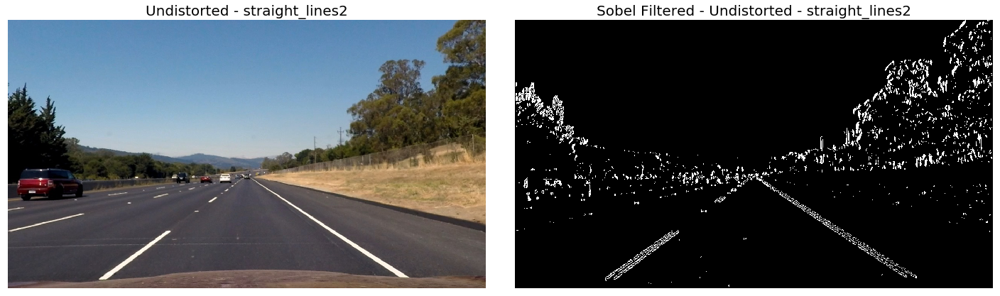

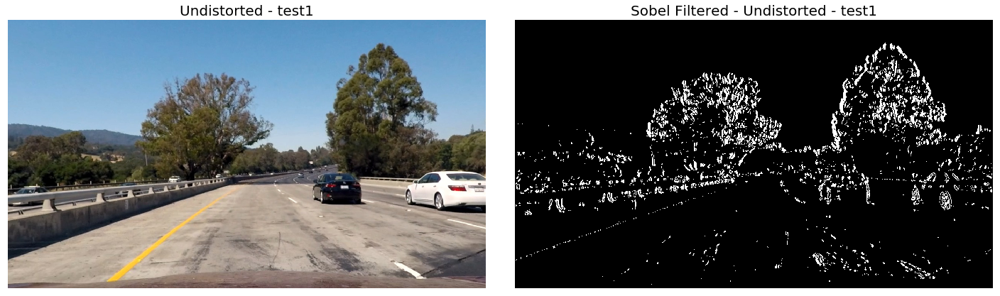

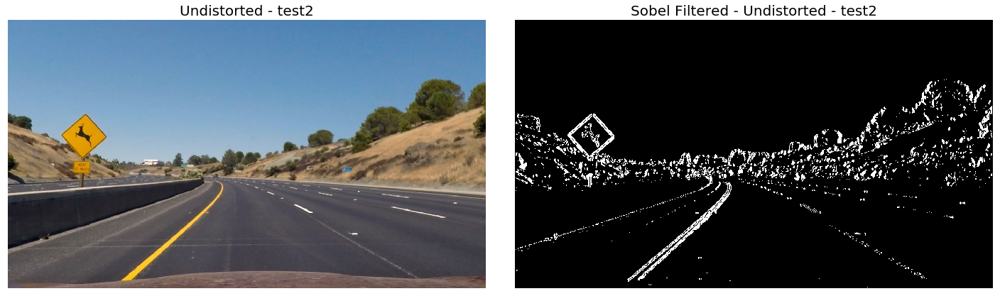

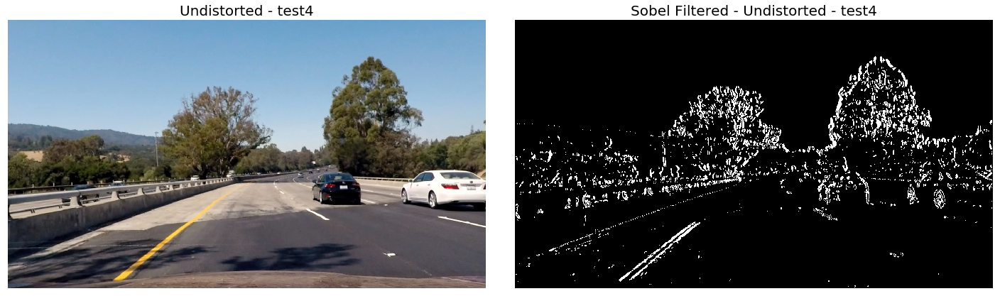

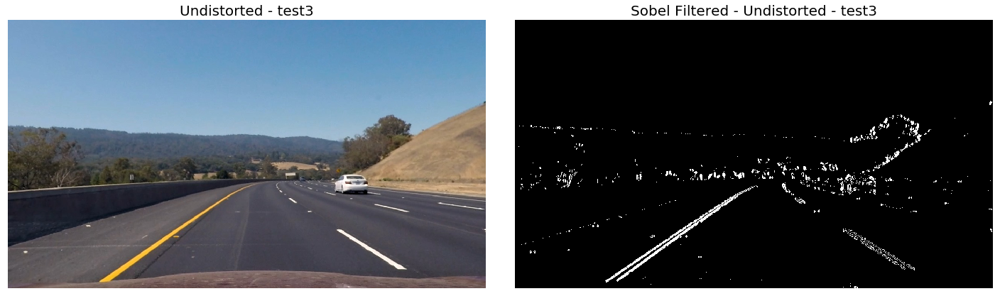

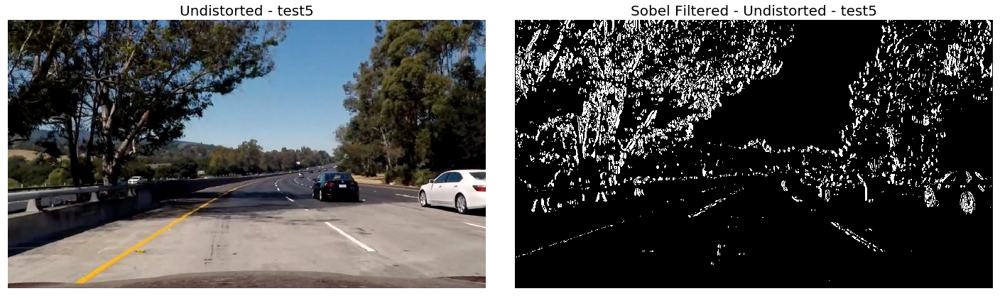

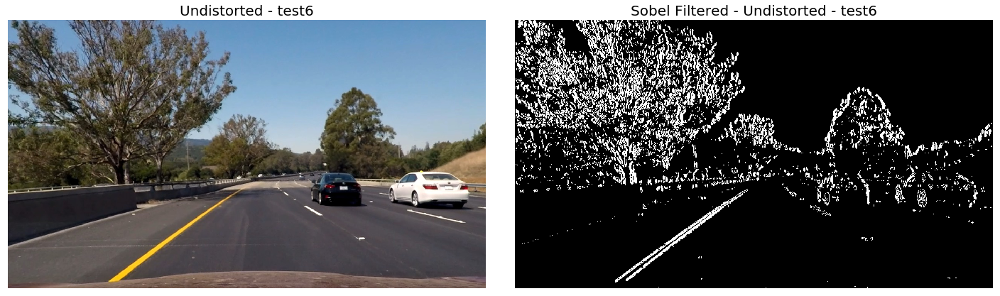

In [24]:
combined_sobel = [[],[]]

for i in range(total_images):
    combined = combineThresh(np.bitwise_and(sobel_x[0][i],sobel_y[0][i]) , 
                                   np.bitwise_and(sobel_mag[0][i],sobel_dir[0][i]))
    
    combined_sobel[0].append(combined) #Image
    combined_sobel[1].append('Sobel Filtered - '+undistorted_imgs[1][i]) #Title
    
    plot_images([undistorted_imgs[0][i],combined_sobel[0][i]],(1,2),(20,6),
                [undistorted_imgs[1][i],combined_sobel[1][i]],[None,'gray'],
                save_plot=1,filepath='output_images/sobel_filtered/sobel_x-y-mag-dir_thresh_vis_'+test_images[1][i],
                title_font=20)

## Colorspace Exploration

* HLS Colorspace
* LAB Colorspace
* RGB Colorspace
    * **Combined Color**

### HLS Colorspace

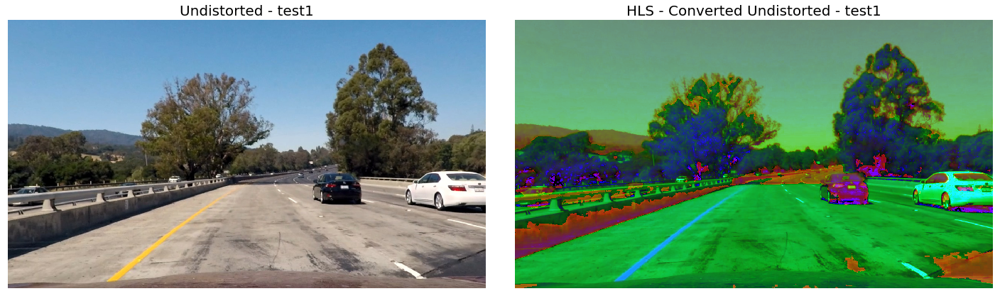

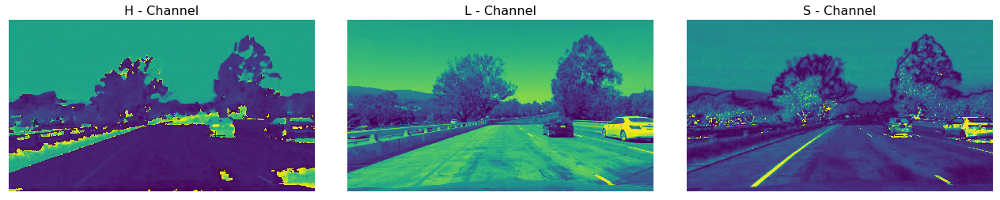

In [25]:
index = 2
img = undistorted_imgs[0][index]
hls_img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

plot_images([img,hls_img],(1,2),(20,6),
            [undistorted_imgs[1][index],'HLS - Converted '+undistorted_imgs[1][index]],
            save_plot=1,filepath='output_images/color_filtered/hls_vis',title_font=20)
            
plot_images([hls_img[:,:,0],hls_img[:,:,1],hls_img[:,:,2]],(1,3),(18,5),
            ['H - Channel','L - Channel','S - Channel'],
            save_plot=1,filepath='output_images/color_filtered/hls_channel_vis')

>### Inference: 
_**It can be observed that the `yellow lane lines` are most evident in the `S-channel` of the `HLS Colorspace` and hence will be the preferred channel for thresholding to obtain a Binary Image**_

### Thresholding S-Channel

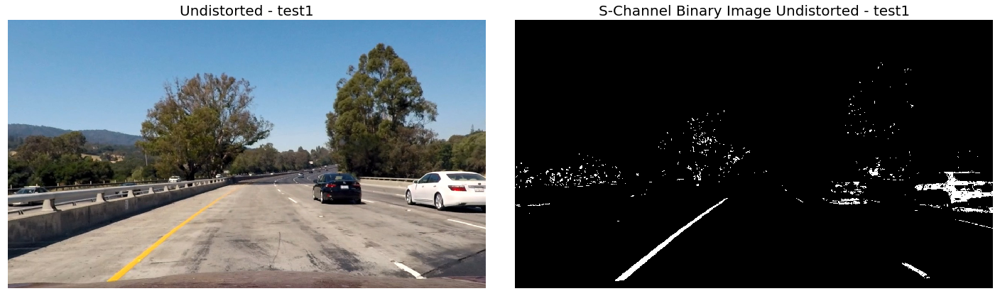

In [26]:
#Threshold Tuning Parameter
s_thresh = (175,255)
s_binary = applyBinaryThresh(hls_img[:,:,2], s_thresh[0], s_thresh[1])

plot_images([img,s_binary],(1,2),(20,6),
            [undistorted_imgs[1][index],'S-Channel Binary Image '+undistorted_imgs[1][index]],[None,'gray'],
            save_plot=1,filepath='output_images/color_filtered/s_thresh_vis',title_font=20)

### LAB Colorspace

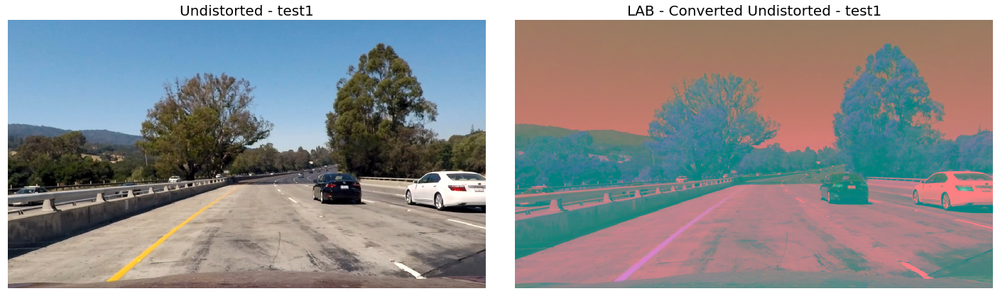

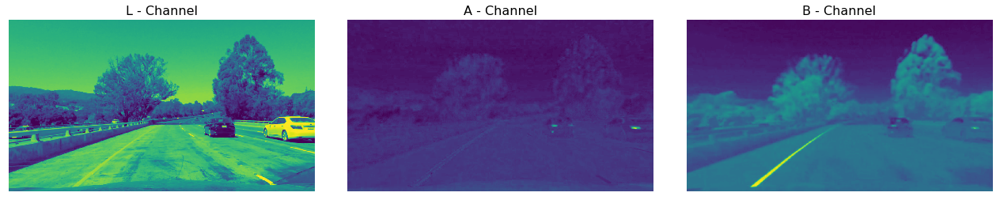

In [27]:
index = 2
img = undistorted_imgs[0][index]
lab_img = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)

plot_images([img,lab_img],(1,2),(20,6),
            [undistorted_imgs[1][index],'LAB - Converted '+undistorted_imgs[1][index]],
            save_plot=1,filepath='output_images/color_filtered/lab_vis',title_font=20)
            
plot_images([lab_img[:,:,0],lab_img[:,:,1],lab_img[:,:,2]],(1,3),(18,5),
            ['L - Channel','A - Channel','B - Channel'],
            save_plot=1,filepath='output_images/color_filtered/lab_channel_vis')

>### Inference: 
_**It can be observed that the `white lane lines` are most evident in the `L-channel` of the `LAB Colorspace` and hence will be the preferred channel for thresholding to obtain a Binary Image**_

### Thresholding L-Channel

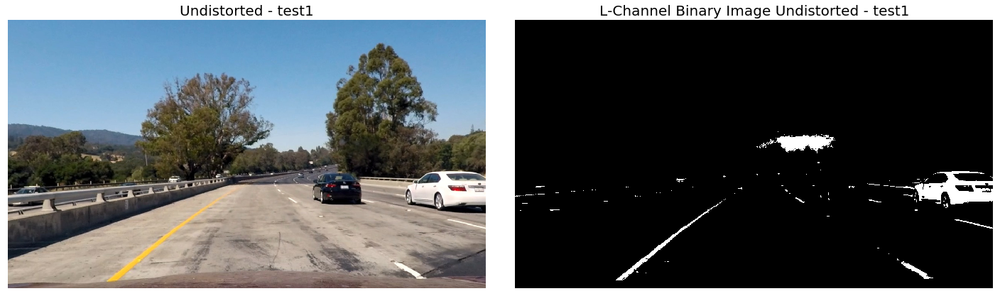

In [28]:
#Threshold Tuning Parameter
l_thresh = (210,255)
l_binary = applyBinaryThresh(lab_img[:,:,0], l_thresh[0], l_thresh[1], False)

plot_images([img,l_binary],(1,2),(20,6),
            [undistorted_imgs[1][index],'L-Channel Binary Image '+undistorted_imgs[1][index]],[None,'gray'],
            save_plot=1,filepath='output_images/color_filtered/l_thresh_vis',title_font=20)

### RGB Colorspace

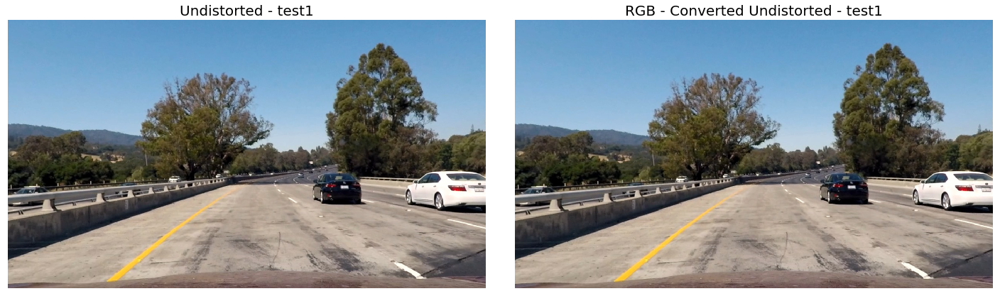

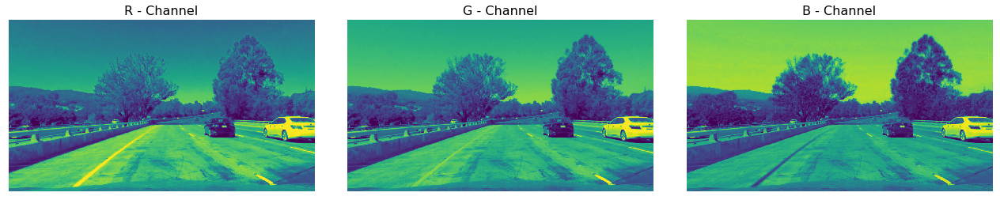

In [29]:
index = 2
img = undistorted_imgs[0][index]
rgb_img = np.copy(img)

plot_images([img,rgb_img],(1,2),(20,6),
            [undistorted_imgs[1][index],'RGB - Converted '+undistorted_imgs[1][index]],
            save_plot=0,filepath='output_images/color_filtered/lab_vis',title_font=20)
            
plot_images([rgb_img[:,:,0],rgb_img[:,:,1],rgb_img[:,:,2]],(1,3),(18,5),
            ['R - Channel','G - Channel','B - Channel'],
            save_plot=0,filepath='output_images/color_filtered/lab_channel_vis')

>### Inference: 
_**It can be observed that the `lane lines` are most evident in the `R & G - channels` of the `RGB Colorspace` and hence will be the preferred channel for thresholding to obtain a Binary Image. Also, this channel will specially help in lane detection where the S and L-channels could fail due to shadows.**_

### Thresholding R & G - Channel

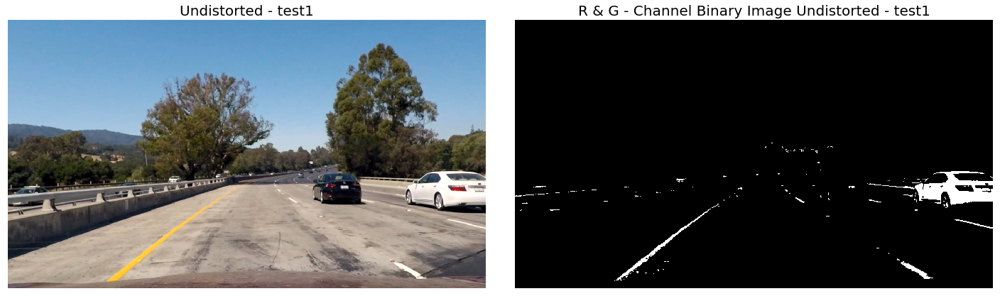

In [30]:
#Threshold Tuning Parameter
r_g_thresh = 200
r = rgb_img[:,:,0] #Selecting R-Channel
g = rgb_img[:,:,1] #Selecting G-Channel
r_g_binary = np.zeros_like(r)
r_g_binary[(r > r_g_thresh) & (g > r_g_thresh)] = 1

plot_images([img,r_g_binary],(1,2),(20,6),
            [undistorted_imgs[1][index],'R & G - Channel Binary Image '+undistorted_imgs[1][index]],[None,'gray'],
            save_plot=1,filepath='output_images/color_filtered/r&g_thresh_vis',title_font=20)

### Combining S-Channel, L-Channel and R & G - Channel Thresholds

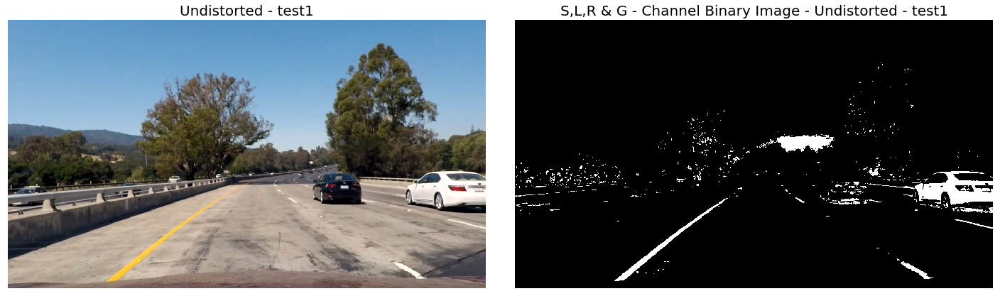

In [31]:
index = 2
img = undistorted_imgs[0][index]

combined_color = combineThresh(combineThresh(l_binary, s_binary), r_g_binary)
plot_images([img,combined_color],(1,2),(20,6),
            [undistorted_imgs[1][index],'S,L,R & G - Channel Binary Image - '+undistorted_imgs[1][index]],[None,'gray'],
            save_plot=1,filepath='output_images/color_filtered/s-l-r&g_thresh_vis',title_font=20)

## Combining Sobel and Color Thresholds

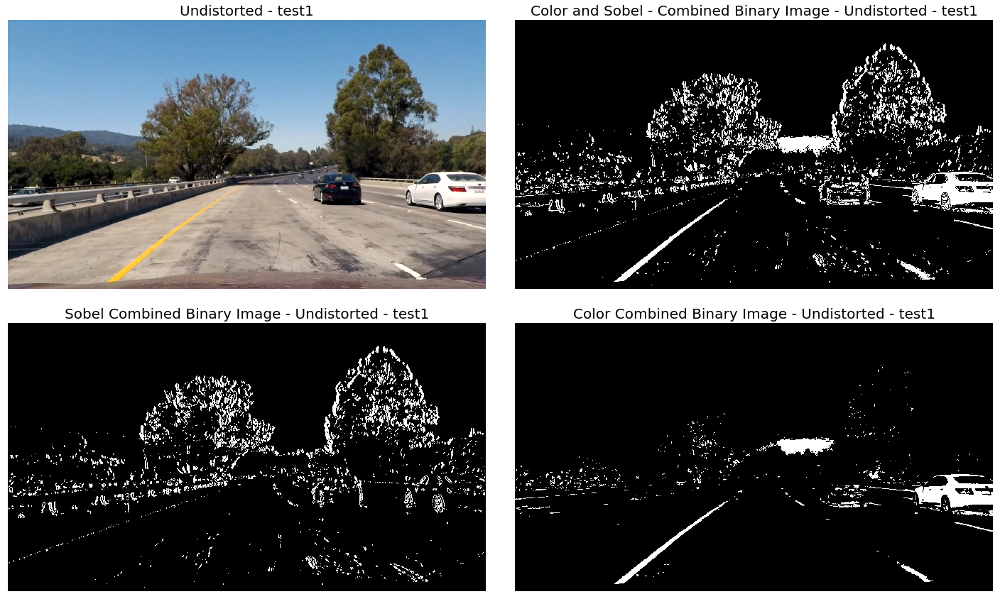

In [32]:
index = 2
img = undistorted_imgs[0][index]

combined = combineThresh(combined_sobel[0][index],combined_color)
plot_images([img,combined,combined_sobel[0][index],combined_color],(2,2),(20,12),
            [undistorted_imgs[1][index],'Color and Sobel - Combined Binary Image - '+undistorted_imgs[1][index],
            'Sobel Combined Binary Image - '+undistorted_imgs[1][index],
            'Color Combined Binary Image - '+undistorted_imgs[1][index]],
            [None,'gray','gray','gray'],
            save_plot=1,filepath='output_images/color_sobel_combined_vis',title_font=20)

## Image Pre-Processing Pipeline

In [33]:
def pre_process(img):
    
    # Sobel Filtering
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    sobel_x_low = 30
    sobel_x_high = 110
    sobel_x = abs_sobel_thresh(gray, 'x', sobel_x_low, sobel_x_high)
    
    sobel_y_low = 30
    sobel_y_high = 110
    sobel_y = abs_sobel_thresh(gray, 'y', sobel_y_low, sobel_y_high)
    
    sobel_kernel = 15
    sobel_mag_low = 30
    sobel_mag_high = 110
    sobel_mag = mag_thresh(gray, sobel_kernel, (sobel_mag_low, sobel_mag_high))
    
    sobel_kernel = 15
    sobel_dir_low = 0.7
    sobel_dir_high = 1.3
    sobel_dir = dir_threshold(gray, sobel_kernel, (sobel_dir_low, sobel_dir_high))

    combined_sobel = combineThresh(np.bitwise_and(sobel_x,sobel_y) , np.bitwise_and(sobel_mag,sobel_dir))

    # Colorspace Filtering
    hls_img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_thresh = (175,255)
    s_binary = applyBinaryThresh(hls_img[:,:,2], s_thresh[0], s_thresh[1])
    
    lab_img = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    l_thresh = (210,255)
    l_binary = applyBinaryThresh(lab_img[:,:,0], l_thresh[0], l_thresh[1], False)
    
    rgb_img = np.copy(img)
    r_g_thresh = 200
    r = rgb_img[:,:,0]
    g = rgb_img[:,:,1]
    r_g_binary = np.zeros_like(r)
    r_g_binary[(r > r_g_thresh) & (g > r_g_thresh)] = 1
    
    combined_color = combineThresh(combineThresh(l_binary, s_binary), r_g_binary)

    combined = combineThresh(combined_sobel,combined_color)
    
    return combined

## Pre-processing Test Images

In [34]:
pp_imgs = [[],[]]
for i in tqdm(range(total_images),desc='Pre-processing'):
    pp_imgs[0].append(pre_process(undistorted_imgs[0][i])) #Image
    pp_imgs[1].append('Pre-Processed - '+undistorted_imgs[1][i][14:]) #Title

print("All test images have been sucessfully pre-processed.")

HBox(children=(IntProgress(value=0, description='Pre-processing: ', max=8), HTML(value='')))


All test images have been sucessfully pre-processed.


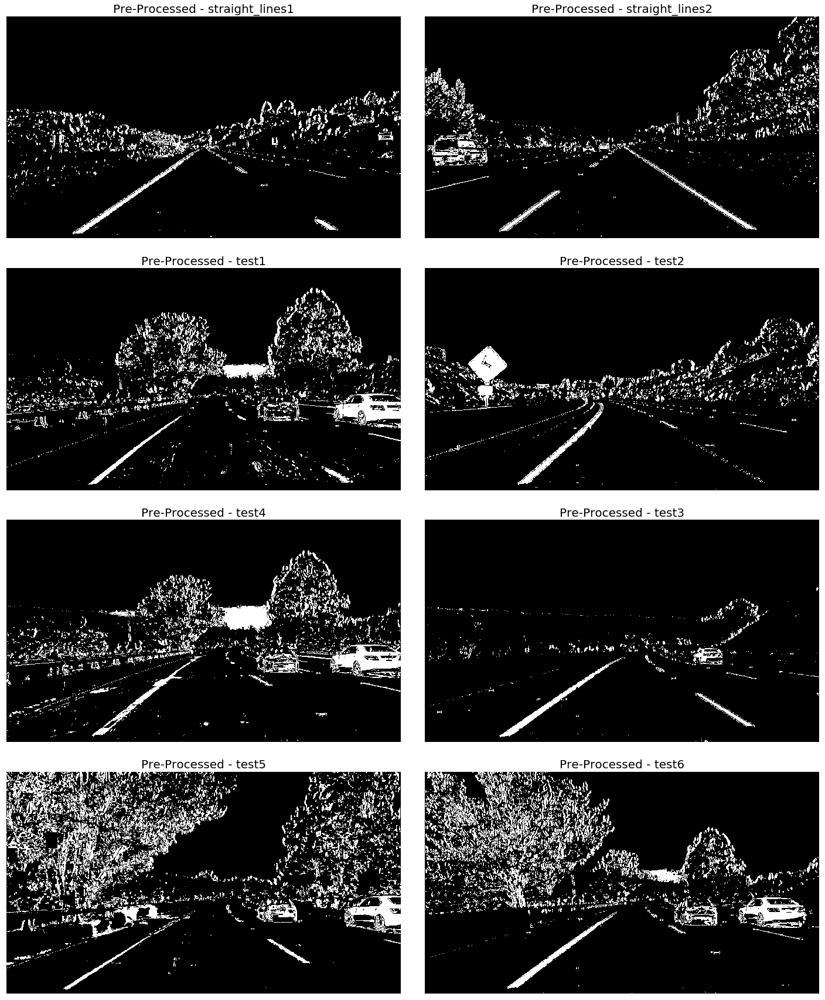

In [35]:
"""DISPLAY ALL Pre-Processed Test Images"""

plot_images(pp_imgs[0],(4,2),(20,24),pp_imgs[1],['gray' for i in range(total_images)],
            save_plot=1,filepath='output_images/pre_processed_test_imgs_vis',title_font=20)

## Region of Interest

The combination of Sobel and Colospace filtering does an amazing job at detecting lane lines but it also detects several other objects and features in the surroundings which would as noise in the pipeline to be processed further. An easy way to filter this noise would be to define an area on the image where the probability of occurence of lane lines is the highest and mask out the image beyond this region of interest. 
Hence the following steps will be followed:
* **Defining ROI**
* **Applying ROI mask**

## Defining ROI

In [36]:
def draw_roi(image, pts):
    pts = pts.reshape((-1, 1, 2))
    cv2.polylines(image, [pts], True, (0, 255, 150),5)

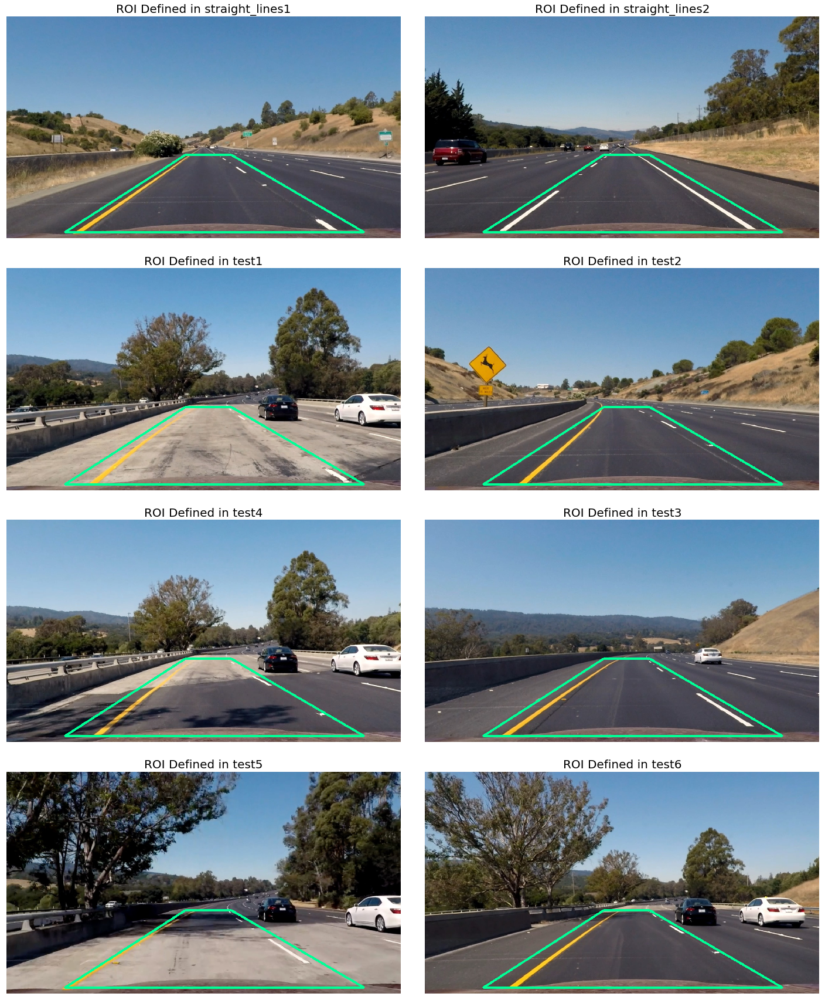

In [37]:
# Defining ROI Points
roi_pts = np.array([[190, 700], [580, 450], [730, 450], [1160, 700]], np.int32)
roi = np.copy(undistorted_imgs)

for i in range(total_images):
    draw_roi(roi[0][i],roi_pts)
    roi[1][i] = 'ROI Defined in {}'.format(undistorted_imgs[1][i][14:])

#DISPLAY ALL Pre-Processed Test Images
plot_images(roi[0],(4,2),(20,24),list(roi[1]),
            save_plot=1,filepath='output_images/roi_test_imgs_vis',title_font=20)

## Applying ROI Mask on Pre-Processed Images

In [38]:
def roi_mask(image, pts):
    img = np.copy(image)
    mask = np.zeros_like(img)
    cv2.fillPoly(mask, [pts],(255,)*3)
    return np.bitwise_and(mask, img)

In [39]:
roi_pts = np.array([[190, 700], [580, 450], [730, 450], [1160, 700]], np.int32)
roi_imgs = [[],[]]
for i in tqdm(range(total_images),desc='ROI Mask'):
    roi_imgs[0].append(roi_mask(pp_imgs[0][i],roi_pts)) #Image
    roi_imgs[1].append('ROI Masked - '+pp_imgs[1][i]) #Title

print("All test images have been sucessfully ROI Masked.")

HBox(children=(IntProgress(value=0, description='ROI Mask: ', max=8), HTML(value='')))


All test images have been sucessfully ROI Masked.


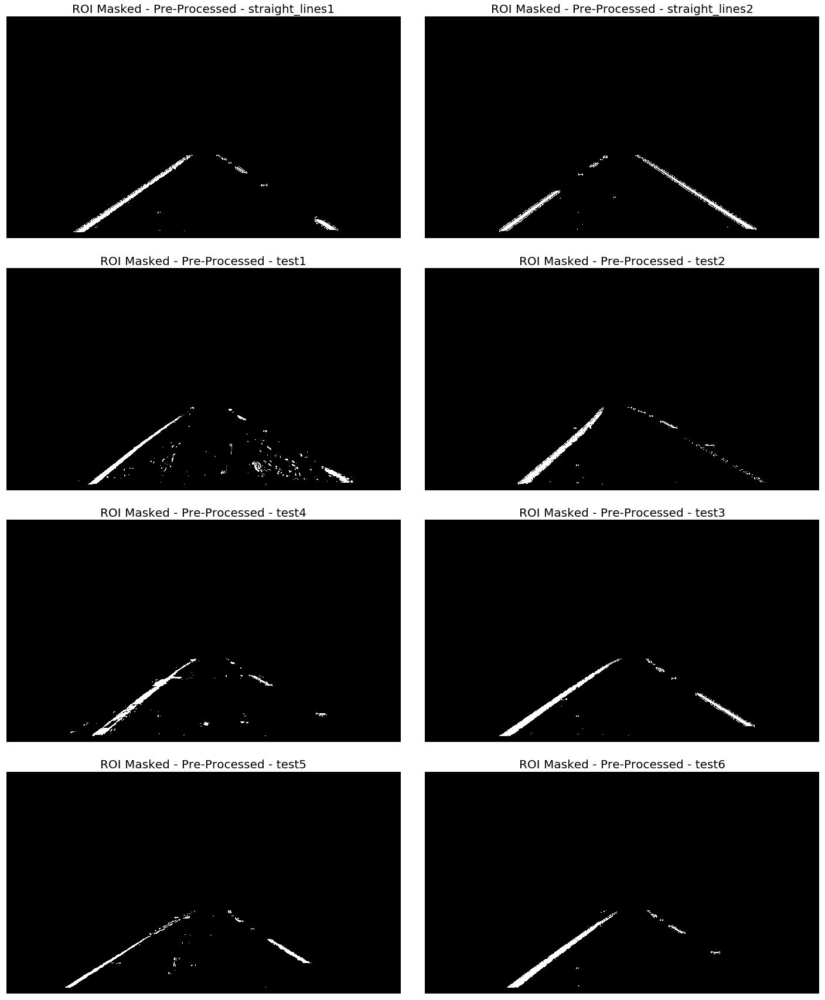

In [40]:
"""DISPLAY ALL ROI Masked Test Images"""

plot_images(roi_imgs[0],(4,2),(20,24),roi_imgs[1],['gray' for i in range(total_images)],
            save_plot=1,filepath='output_images/roi_masked_imgs_vis',title_font=20)

## Perspective Transform
In this step I will define a function **`warp()`** which transforms the undistorted image to a "birds eye view" of the road which focuses only on the lane lines and displays them in such a way that they appear to be relatively parallel to eachother. This will make it easier later on to fit polynomials to the lane lines and measure the curvature.

In [41]:
def warp(image):
    img_size = (int(image.shape[1]), int(image.shape[0]))
    src = np.array([[190, 700], [580, 450], [
                   730, 450], [1160, 700]], np.float32)
    dst = np.array([[380, 720], [380, 10], [950, 10], [950, 720]], np.float32)
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(image, M, img_size,flags=cv2.INTER_LINEAR)

    # Return the resulting image and matrix
    return warped

def unwarp(image, img_size):
    src = np.array([[190, 700], [580, 450], [
                   730, 450], [1160, 700]], np.float32)
    dst = np.array([[380, 720], [380, 10], [950, 10], [950, 720]], np.float32)
    # Given src and dst points, calculate the perspective transform matrix
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(image, Minv, img_size,flags=cv2.INTER_LINEAR)

    # Return the resulting image and matrix
    return warped

### Warpping ROI Masked Images

In [42]:
warp_imgs = [[],[]]
for i in tqdm(range(total_images),desc='ROI Mask'):
    warp_imgs[0].append(warp(roi_imgs[0][i])) #Image
    warp_imgs[1].append('Warpped - '+roi_imgs[1][i]) #Title

print("All test images have been sucessfully ROI Masked.")

HBox(children=(IntProgress(value=0, description='ROI Mask: ', max=8), HTML(value='')))


All test images have been sucessfully ROI Masked.


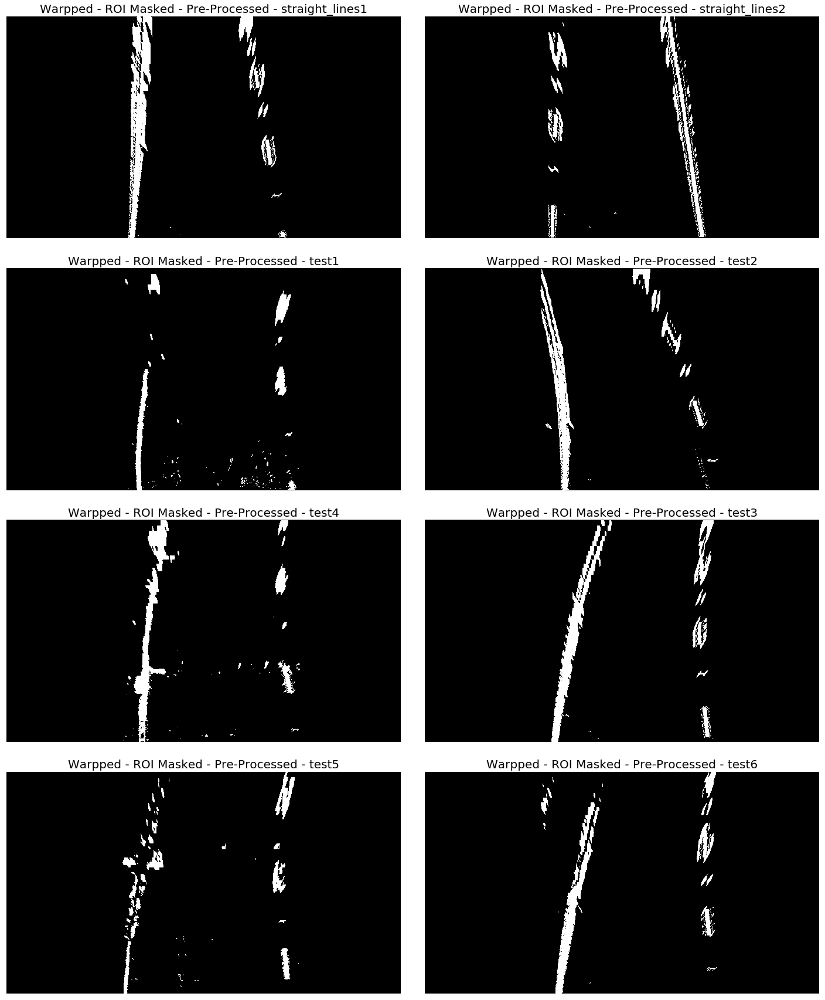

In [43]:
"""DISPLAY ALL ROI Masked Test Images"""

plot_images(warp_imgs[0],(4,2),(20,24),warp_imgs[1],['gray' for i in range(total_images)],
            save_plot=1,filepath='output_images/warpped_imgs_vis',title_font=20)

## Finding Lanes

At this point I was able to use the combined binary image to isolate lane line pixels and fit a polynomial to each of the lane lines. The space in between the identified lane lines is filled in to highlight the driveable area in the lane. The position of the vehicle was measured by taking the average of the x intercepts of each line.

The next step was to fit a polynomial to each lane line, which was done by:

* Identifying peaks in a histogram of the image to determine location of lane lines.
* Identifying all non zero pixels around histogram peaks using the numpy function numpy.nonzero().
* Fitting a polynomial to each lane using the numpy function numpy.polyfit().

The `sliding_window_search()` and `swNeighbourSearch` help us to do the above mentioned steps.

### Sliding Window Search

In [44]:
def sliding_window_search(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]) // 2:, :], axis=0)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0] / 2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 10
    # Set height of windows
    window_height = np.int(binary_warped.shape[0] / nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    # Rectangle data for visualization
    rectangle_data = []
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        rectangle_data.append((win_y_low, win_y_high, win_xleft_low,
                               win_xleft_high, win_xright_low, win_xright_high))
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    left_fit, right_fit = (None, None)
    # Fit a second order polynomial to each
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)

    visualization_data = [rectangle_data, histogram, binary_warped]

    return leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data

In [45]:
# Sliding Window search visualization
def showSWsearch(leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data):
    ploty = np.linspace(
        0, visualization_data[2].shape[0] - 1, visualization_data[2].shape[0])
    left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]

    out_img = np.dstack(
        (visualization_data[2], visualization_data[2], visualization_data[2])) * 255
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    rectangles = visualization_data[0]
    for rect in rectangles:
        cv2.rectangle(out_img, (rect[2], rect[0]), (rect[3], rect[1]),
                      (0, 255, 0), 2)
        cv2.rectangle(out_img, (rect[4], rect[0]), (rect[5], rect[1]),
                      (0, 255, 0), 2)
    graph_data = [left_fitx, right_fitx]
    return out_img, graph_data

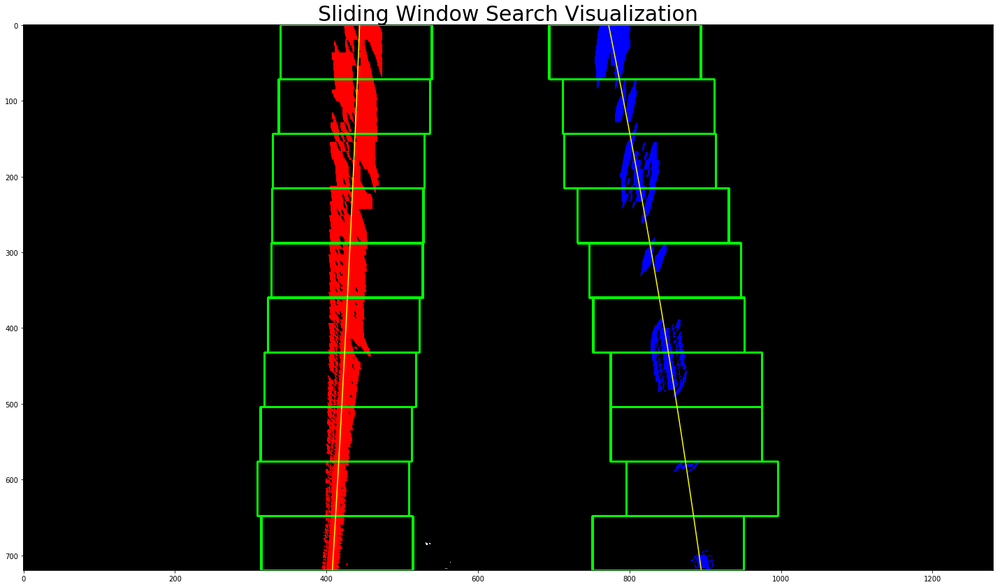

In [68]:
sample_warp = warp_imgs[0][0]
leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data = sliding_window_search(sample_warp)
out_img,graph_data = showSWsearch(leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data)

f, ax = plt.subplots(1, 1, figsize=(20,12))
f.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=None)
plt.tight_layout()

ploty = np.linspace(0, visualization_data[2].shape[0] - 1, visualization_data[2].shape[0])
ax.imshow(out_img)
ax.plot(graph_data[0],ploty, color='yellow')
ax.plot(graph_data[1],ploty, color='yellow')
ax.set_title('Sliding Window Search Visualization', fontsize=30)
f.savefig('output_images/sliding_window_search_vis')
plt.show()

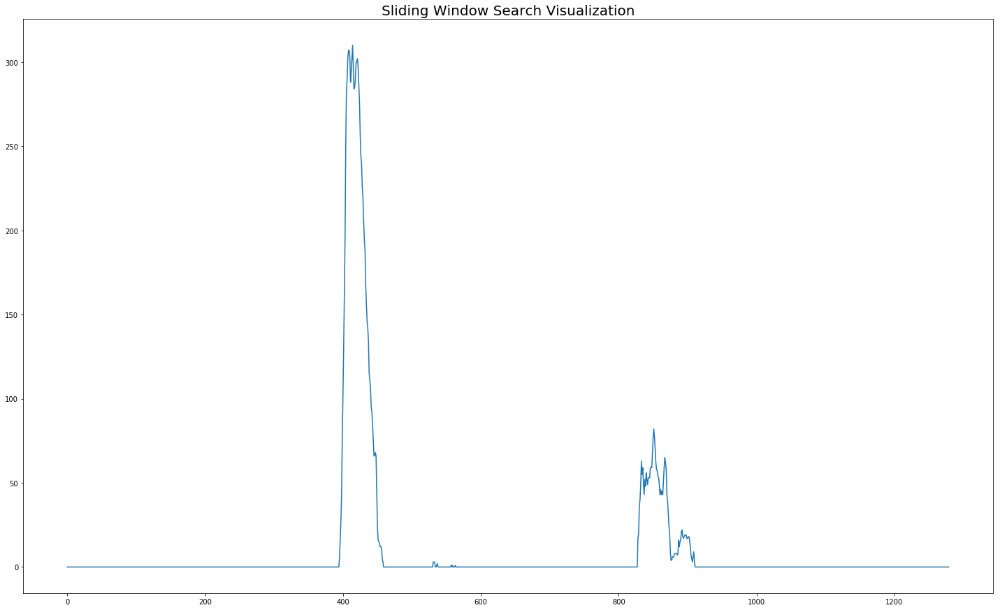

In [69]:
f, ax = plt.subplots(1, 1, figsize=(20,12))
f.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=None)
plt.tight_layout()

plt.plot(visualization_data[1])
ax.set_title('Sliding Window Search Visualization', fontsize=20)
f.savefig('output_images/histogram_vis')
plt.show()

### Neighbouring Search

In [49]:
def swNeighbourSearch(binary_warped, left_fit, right_fit):
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy +
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) +
    left_fit[1]*nonzeroy + left_fit[2] + margin)))

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy +
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) +
    right_fit[1]*nonzeroy + right_fit[2] + margin)))

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    visualization_data = [binary_warped, margin]
    left_fit, right_fit = (None, None)
    # Fit a second order polynomial to each
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)

    return leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data

In [50]:
# Neighbouring Search Visualization
def showNeighbourSearch(leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data):
    # Create an image to draw on and an image to show the selection window
    binary_warped = visualization_data[0]
    out_img = np.dstack((binary_warped, binary_warped, binary_warped)) * 255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    margin = visualization_data[1]
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx - margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx + margin,
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx - margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx + margin,
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0, 255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0, 255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    return result

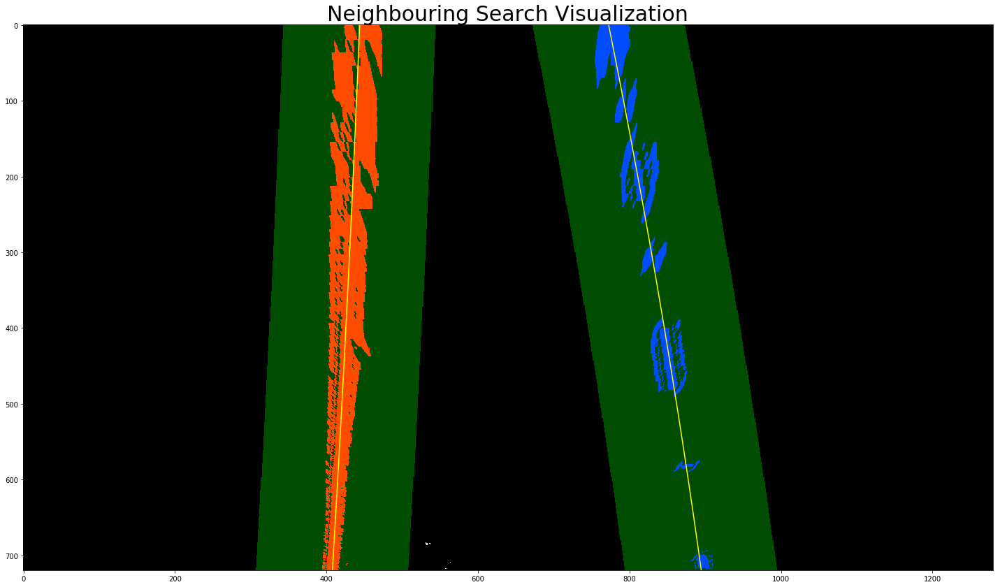

In [70]:
f, ax = plt.subplots(1, 1, figsize=(20,12))
f.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=None)
plt.tight_layout()

sample_warp = warp_imgs[0][0]
leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data = sliding_window_search(sample_warp)
out_img,graph_data = showSWsearch(leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data)
ploty = np.linspace(0, visualization_data[2].shape[0] - 1, visualization_data[2].shape[0])
ax.plot(graph_data[0],ploty, color='yellow')
ax.plot(graph_data[1],ploty, color='yellow')

leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data = swNeighbourSearch(sample_warp, left_fit, right_fit)

result = showNeighbourSearch(leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data)
ax.imshow(result)

ax.set_title('Neighbouring Search Visualization', fontsize=30)
f.savefig('output_images/neighbouring_search_vis')
plt.show()

## Finding Curvature

After fitting the polynomials I was able to calculate the position of the vehicle with respect to center with the following calculations:

* Calculated the average of the x intercepts from each of the two polynomials position = (rightx_int+leftx_int)/2.

* Calculated the distance from center by taking the absolute value of the vehicle position minus the halfway point along the horizontal axis distance_from_center = abs(image_width/2 - position)

* If the horizontal position of the car was greater than image_width/2 than the car was considered to be left of center, otherwise right of center.

Finally, the distance from center was converted from pixels to meters by multiplying the number of pixels by 3.7/700. Next I used the following code to calculate the radius of curvature for each lane line in meters. The final radius of curvature was taken by average the left and right curve radiuses.


In [79]:
def findCurvature(binary_warped, leftx, rightx, lefty, righty, r_fit_x_int, l_fit_x_int):
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 0.04285   # meters per pixel in y dimension
    xm_per_pix = 0.005285  # meters per pixel in x dimension
    y_eval = np.max(ploty)
    if len(leftx) != 0 and len(rightx) != 0:
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty * ym_per_pix, leftx * xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)

        left_curverad = ((1 + (2 * left_fit_cr[0] * y_eval * ym_per_pix + left_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * left_fit_cr[0])
        right_curverad = ((1 + (2 * right_fit_cr[0] * y_eval * ym_per_pix + right_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * right_fit_cr[0])
    # print(left_curverad, right_curverad)
    if left_fit_cr is not None and right_fit_cr is not None:
        car_position = binary_warped.shape[1] / 2
        h = binary_warped.shape[0]
        # l_fit_x_int = left_fit_cr[0]*h**2 + left_fit_cr[1]*h + left_fit_cr[2]
        # r_fit_x_int = right_fit_cr[0]*h**2 + right_fit_cr[1]*h + right_fit_cr[2]
        lane_center_position = (r_fit_x_int + l_fit_x_int) /2
        center_dist = (car_position - lane_center_position) * xm_per_pix

    return left_curverad, right_curverad, center_dist

## Visual Display of the Lane Boundaries and Numerical Estimation

In [72]:
def draw_data(original_img, curv_rad, center_dist):
    new_img = np.copy(original_img)
    font = cv2.FONT_HERSHEY_SIMPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(curv_rad) + 'm'
    cv2.putText(new_img, text, (100, 90), font, 1.5, (255,255,255), 2,cv2.LINE_AA)
    direction = ''
    if center_dist > 0:
        direction = 'right'
    elif center_dist < 0:
        direction = 'left'
    abs_center_dist = abs(center_dist)
    text = '{:04.3f}'.format(abs_center_dist) + 'm ' + direction + ' of center'
    cv2.putText(new_img, text, (100, 150), font, 1.5, (255,255,255), 2,cv2.LINE_AA)
    return new_img


def drawLane(warped, left_fit, right_fit, image_shape, undist):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    ploty = np.linspace(0, warped.shape[0] - 1, warped.shape[0])
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp, image_shape)
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    return result

In [75]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False
        # x values of the last n fits of the line
        self.recent_xfitted = []
        # average x values of the fitted line over the last n iterations
        self.bestx = []
        # polynomial coefficients averaged over the last n iterations
        self.best_fit = None
        # polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]
        # radius of curvature of the line in some units
        self.radius_of_curvature = None
        # distance in meters of vehicle center from the line
        self.line_base_pos = None
        # difference in fit coefficients between last and new fits
        self.diffs = np.array([0, 0, 0], dtype='float')
        # x values for detected line pixels
        self.allx = None
        # y values for detected line pixels
        self.ally = None

    def addFit(self, fit):
        self.current_fit = fit
        if self.current_fit is not None:
            # print self.best_fit
            if self.best_fit is not None:
                # Compare with Best Fit
                self. diffs = abs(self.current_fit - self.best_fit)
            if((self.diffs[0] > 0.001 - self.diffs[1] > 1 - self.diffs[2] > 100).any()):
                # discard current
                self.detected = False
            else:
                self.detected = True
                self.recent_xfitted.append(self.current_fit)
                if len(self.recent_xfitted) > 8:
                    self.recent_xfitted = self.recent_xfitted[len(self.recent_xfitted) - 8:]

                self.best_fit = np.average(self.recent_xfitted, axis=0)
                self.bestx.append(self.best_fit)
                # print self.best_fit
        else:
            self.detected = False
            if len(self.recent_xfitted) > 0:
                self.recent_xfitted = self.recent_xfitted[:len(self.recent_xfitted) - 1]
            self.best_fit = np.average(self.recent_xfitted, axis=0)
            self.bestx.append(self.best_fit)

In [83]:
def findLanes(image):
    img_size = (int(image.shape[1]), int(image.shape[0]))
    image = undistort(image, cameraMatrix, distortionCoeffs)
    undist = image
    roi_pts = np.array([[190, 700], [580, 450], [730, 450], [1160, 700]], np.int32)
    image = pre_process(undist)
    image = roi_mask(image, roi_pts)
    warped = warp(image)
    
    if not Left.detected or not Right.detected:
        leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data = sliding_window_search(warped)
    else:
        leftx, rightx, lefty, righty, left_fit, right_fit, visualization_data = swNeighbourSearch(warped, Left.best_fit, Right.best_fit)

    if left_fit is not None and right_fit is not None:
        # Calculate the intercepts
        h = warped.shape[0]
        l_fit_x_int = left_fit[0]*h**2 + left_fit[1]*h + left_fit[2]
        r_fit_x_int = right_fit[0]*h**2 + right_fit[1]*h + right_fit[2]
        int_diff = abs(l_fit_x_int - r_fit_x_int)
        # print int_diff
        diff = abs(int_diff - 500)
        # print diff

        if not ((diff) > 50):
            # Do Something
            Left.addFit(left_fit)
            Right.addFit(right_fit)
        else:
            Left.best_fit = Left.bestx[-1]
            Right.best_fit = Right.bestx[-1]

    left_curverad, right_curverad, center_dist = findCurvature(warped, leftx, rightx, lefty, righty, r_fit_x_int, l_fit_x_int)
    result = drawLane(warped, Left.best_fit, Right.best_fit, img_size, undist)
    result = draw_data(result, left_curverad, center_dist)
    return result


### Sample Lane Draw Visualization

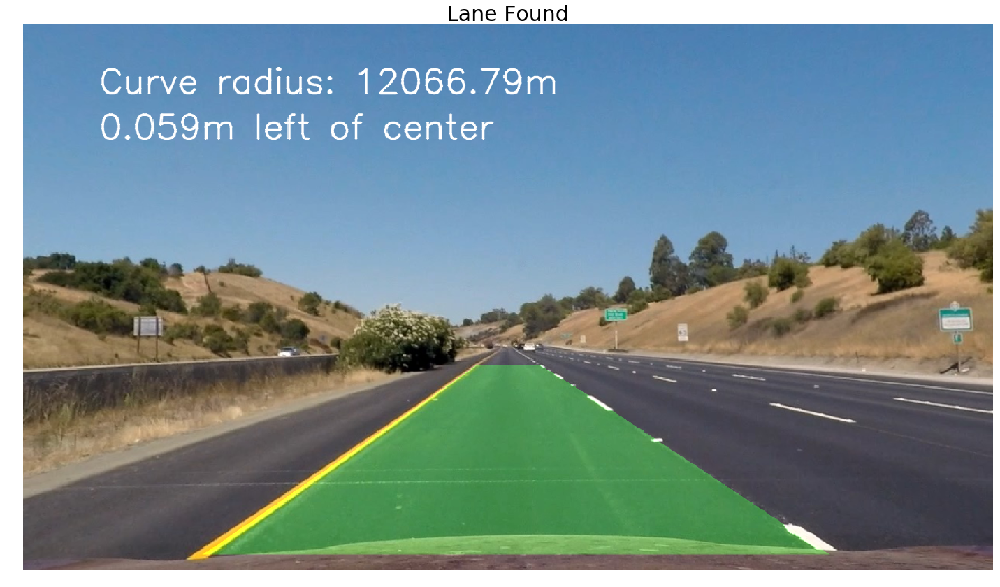

In [84]:
Right = Line()
Left = Line()
sample = mpimg.imread('test_images/straight_lines1.jpg') 
result = findLanes(sample)

f, ax = plt.subplots(1, 1, figsize=(20,12))
f.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=None)
plt.tight_layout()


ax.imshow(result)
ax.set_title('Lane Found', fontsize=30)
ax.axis('off')
f.savefig('output_images/sample_lane_detect_vis')
plt.show()

## Pipeline Testing on Project Video

In [85]:
Right = Line()
Left = Line()
project_output = 'project_video_out.mp4'
clip = VideoFileClip('project_video.mp4')
project_clip = clip.fl_image(findLanes)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4


100%|█████████▉| 1260/1261 [11:11<00:00,  1.87it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 8min 59s, sys: 3.14 s, total: 9min 2s
Wall time: 11min 14s


In [86]:
proj_out_file = 'project_video_out.mp4'

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(proj_out_file))